## Step 2 Introduction
This is where the magic happens!  This notebook predicts the price of an item based on input image with the following steps:

1.) The csv we created in the EDA data extraction notebook is imported as a csv.  

2.) We set up our pretrained tensorflow CNN model and define a function to extract image embeddings with the model using predict().  Many models use the embeddings to tag or annotate images, we strip this part and just use the feature vectors / embedding extraction.  

3.) The image embeddings are added back to the dataframe for the corresponding image (that in turn also represents a product/item).  

4.) We extract the image embedding from a new source image or "original image".

5.) We calculate the cosine distance from each of the embeddings in our dataframe as a distance from our original image embedding and then output a list of most similar images in asccending order (lowest cosine distance first).

6.) We run the model as a batch and output embeddings to a 2D space to visualize groupings and model performance.

7.) We then implement Triplet loss function to attempt to group similar classes closer together with our model providing higher accuracy and analyse results.  Also tried to implement ViT with lesser results without training model.

8.) Conclusion: see below for outcomes and next steps with recomendations

In [1]:
import tensorflow as tf
import tensorflow_hub as hub
from tensorflow.keras import models, layers
from sklearn.model_selection import train_test_split
from PIL import Image
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from collections import defaultdict
import random
import tensorflow_addons as tfa
import plotly.express as px
import numpy as np
import pandas as pd
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3' 
import warnings
warnings.filterwarnings('ignore')

/Users/stephenthorpe/anaconda3/envs/tf/lib/python3.11/site-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(
/Users/stephenthorpe/anaconda3/envs/tf/lib/python3.11/site-packages/tensorflow_addons/utils/ensure_tf_install.py:53: UserWarning: Tensorflow Addons supports using Python ops for all Tensorflow versions above or equal to 2.13.0 and strictly below 2.16.0 (nightly versions are not supported). 
 The versions of TensorFlow you are currently using is 2.12.0 and is not supported. 
Some things might work, some things might not.
If you were to encounter a bug,

In [2]:
#import our dataset with images
df = pd.read_csv('scraping/EBAY_images_2024-05-20-.csv')
df.head(5)

,ebay_id,title,location,condition,artist,release_year,image_url,sleeve_grading,record_grading,sold_date,sold,shipping_cost,image_file,label
0,4.049467e+11,Vtg Fleetwood Mac - Rumours Vinyl Record LP & ...,"Located in: Henderson, North Carolina, United ...",Used: An item that has been used previously. S...,Fleetwood Mac,1977,https://i.ebayimg.com/images/g/8KoAAOSwEFpmLZ5...,NaN,NaN,NaN,19.90,4.87,8KoAAOSwEFpmLZ53_s-l500.webp,Fleetwood Mac
1,2.261252e+11,Fleetwood Mac - Rumours - 1977 - Warner Bros B...,"Located in: Keyport, New Jersey, United States",Used: An item that has been used previously. S...,"Fleetwood Mac, Lindsey Buckingham, Stevie Nicks",1977,https://i.ebayimg.com/images/g/u0cAAOSwGdJmM89...,Good Plus (G+),Very Good Plus (VG+),NaN,13.50,4.85,u0cAAOSwGdJmM89m_s-l500.webp,Fleetwood Mac
2,3.951387e+11,Barry White Vinyl Record Lot - Can't Get Enoug...,"Located in: Merrimack, New Hampshire, United S...",UsedAn item that has been used previously. See...,"BEATLES, Barry White",NaN,https://i.ebayimg.com/images/g/rVIAAOSwE1NlptS...,NaN,NaN,NaN,49.99,NaN,rVIAAOSwE1NlptSv_s-l500.webp,Non Searched
3,1.667386e+11,FLEETWOOD MAC - Rumours - Vinyl L.P Warner Bro...,"Located in: Saint Louis, Missouri, United States",Used: An item that has been used previously. S...,Fleetwood Mac,1977,https://i.ebayimg.com/images/g/zK0AAOSwEFpmJj0...,Very Good (VG),Good Plus (G+),"May 06, 2024 16:11:12 PDT",16.00,5.50,zK0AAOSwEFpmJj0Q_s-l500.webp,Fleetwood Mac
4,2.047300e+11,CREAM ERIC CLAPTON LP VINYL LOT ORIGINAL LAYLA...,"Located in: Patchogue, New York, United States",Used: An item that has been used previously. S...,"Cream, Eric Clapton, Derek and the Dominos",NaN,https://i.ebayimg.com/images/g/KSYAAOSwmb1mEZZ...,Very Good Plus (VG+),Excellent (EX),"Apr 11, 2024 17:02:23 PDT",41.00,5.61,KSYAAOSwmb1mEZZh_s-l1600.webp,Non Searched


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 406 entries, 0 to 405
Data columns (total 14 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   ebay_id         406 non-null    float64
 1   title           406 non-null    object 
 2   location        406 non-null    object 
 3   condition       404 non-null    object 
 4   artist          403 non-null    object 
 5   release_year    229 non-null    object 
 6   image_url       406 non-null    object 
 7   sleeve_grading  282 non-null    object 
 8   record_grading  288 non-null    object 
 9   sold_date       166 non-null    object 
 10  sold            406 non-null    float64
 11  shipping_cost   387 non-null    float64
 12  image_file      406 non-null    object 
 13  label           406 non-null    object 
dtypes: float64(3), object(11)
memory usage: 44.5+ KB


In [3]:
# here we chose a model with pretrained weights specifically for feature extraction on our local machine
# it has 7,768,562 parameters and outputs 1408 feature embeddings
model_uri = 'https://www.kaggle.com/models/tensorflow/efficientnet/TensorFlow2/b2-feature-vector/1'

width = height = expect_img_size = 260

layer = hub.KerasLayer(model_uri)
model = tf.keras.Sequential([layer])
model.build([None, expect_img_size, expect_img_size, 3])  # Batch input shape.
model.summary()

#model = models.Sequential([
#    layers.Flatten(),
#    layers.Dense(128, activation=tf.nn.relu),
#    layers.Dense(10, activation=tf.nn.softmax)
#])

#model.compile(optimizer=tf.keras.optimizers.Adam(), loss='sparse_categorical_crossentropy')

OSError: SavedModel file does not exist at: /var/folders/q2/3629kqd10199c_1f07d16_6c0000gn/T/tfhub_modules/0af1c3e8e974a9329d2307927b9978f645da0ce7/{saved_model.pbtxt|saved_model.pb}

In [9]:
#This is a function to extract the embedding using the model, hide print if we have a lot of images
IMAGE_SHAPE = (260, 260)
def extract(file):
  file = Image.open(file).convert('L').resize(IMAGE_SHAPE) #open file convert to b&w and resize
  #display(file)

  file = np.stack((file,)*3, axis=-1) #as model expects RGB we input b&w in 3 channels

  file = np.array(file)/255.0 #normalizes the image from 256 values to 0-1

  embedding = model.predict(file[np.newaxis, ...]) #makes 3d array to 4d input like 1, height, width, channels as model built to run on arrays of values
  #print(embedding)
  vgg16_feature_np = np.array(embedding)
  flattended_feature = vgg16_feature_np.flatten()

  print(len(flattended_feature))
  #print(flattended_feature)
  print('-----------')
  return flattended_feature

In [55]:
image_files = np.array(df.loc[0:,'image_file'])
embeddings = [] 
for image in image_files:
    print('extracting image:', image)
    embedding = extract('scraping/files/' + image)
    #embedding = list(embedding)
    row = [image, embedding]
    embeddings.append(row)
#add embedding to df for image
# Create a dictionary from the embeddings list
embeddings_dict = {name: embedding for name, embedding in embeddings}
# Update the 'image_embedding' column
df['image_embedding'] = df['image_file'].map(embeddings_dict)

extracting image: 8KoAAOSwEFpmLZ53_s-l500.webp
1/1 [==============================] - 0s 71ms/step
1408
-----------
extracting image: u0cAAOSwGdJmM89m_s-l500.webp
1/1 [==============================] - 0s 61ms/step
1408
-----------
extracting image: rVIAAOSwE1NlptSv_s-l500.webp
1/1 [==============================] - 0s 61ms/step
1408
-----------
extracting image: zK0AAOSwEFpmJj0Q_s-l500.webp
1/1 [==============================] - 0s 60ms/step
1408
-----------
extracting image: KSYAAOSwmb1mEZZh_s-l1600.webp
1/1 [==============================] - 0s 58ms/step
1408
-----------
extracting image: 5ocAAOSwilxmMV~O_s-l1600.webp
1/1 [==============================] - 0s 57ms/step
1408
-----------
extracting image: czIAAOSwC2xlDQ1-_s-l500.webp
1/1 [==============================] - 0s 58ms/step
1408
-----------
extracting image: xO0AAOSwQA9mGDCo_s-l1600.webp
1/1 [==============================] - 0s 52ms/step
1408
-----------
extracting image: NQ4AAOSwWp5mO35B_s-l500.webp
1/1 [=================

In [56]:
# get embeddings from a new image to compare to our dataset
origin_embedding = extract('input-images/' + 'origin-image.webp')
origin_embedding = list(origin_embedding)

1/1 [==============================] - 0s 57ms/step
1408
-----------


In [57]:
from scipy.spatial import distance
metric = 'cosine'

In [58]:
# run through df embeddings and calc cosine distance from original image then order smallest
# to largest with filename as reference
image_embeddings = np.array(df.iloc[0:, [12, 13]])
distances = []
for i in range(len(image_embeddings)):
    image_file = df.iloc[i, 12]
    image_embedding = df.iloc[i, 13]  # Reshape to 2D array
    dist = float(distance.cdist([origin_embedding], [image_embedding], metric)[0])
    row = [image_file, dist]
    distances.append(row) 
distances = sorted(distances, reverse = True) 

In [59]:
sorted_distances = sorted(distances, key=lambda x: x[1])

Your items value based on 410 comparable items sold is:

--$ 28.49846341463415 --

-> Min Price sold: $ 0.99
-> Max Price sold: $ 718.0
 
Details -> Top  410  most similar items found:



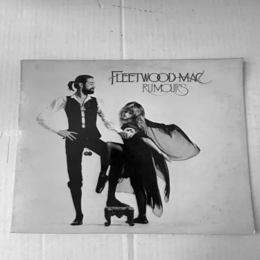

Distance from original: 0.1909420457537372


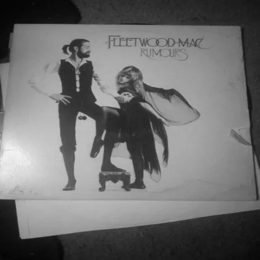

Distance from original: 0.20505047915210417


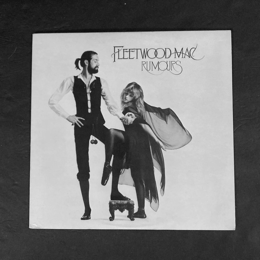

Distance from original: 0.2091626059598991


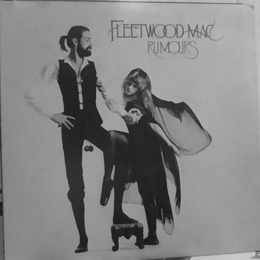

Distance from original: 0.20964424264170245


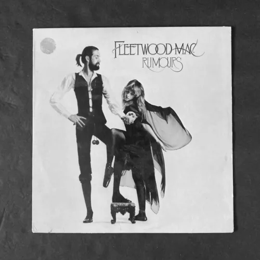

Distance from original: 0.23521533934735095


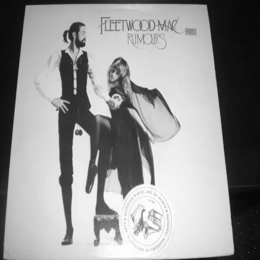

Distance from original: 0.25156188969300797


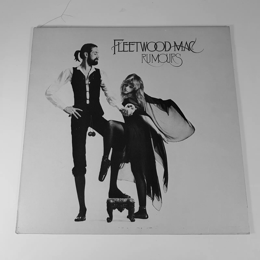

Distance from original: 0.2523391061526864


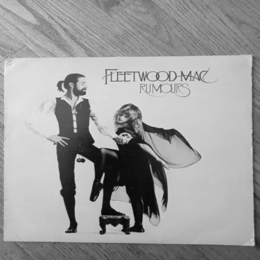

Distance from original: 0.2572103399321255


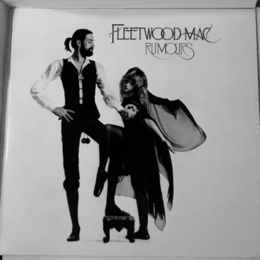

Distance from original: 0.27418822167393087


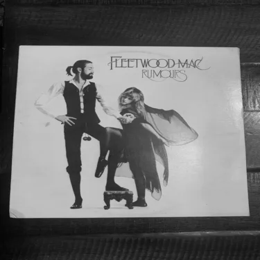

Distance from original: 0.2777592400819485


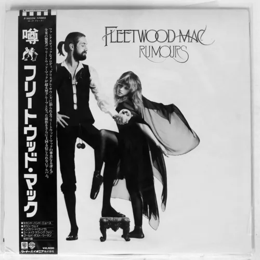

Distance from original: 0.27928077900846404


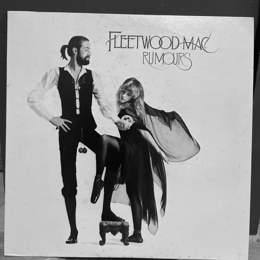

Distance from original: 0.28623368755381706


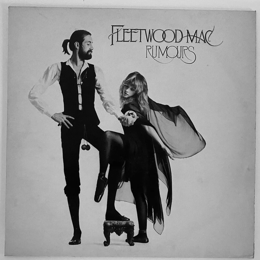

Distance from original: 0.2887551038084899


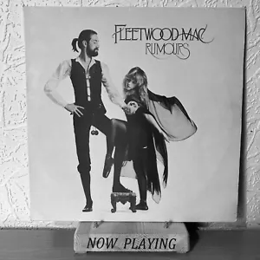

Distance from original: 0.29899608610438744


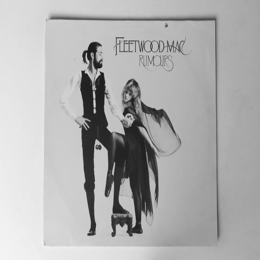

Distance from original: 0.3104342032508901


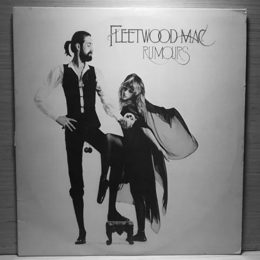

Distance from original: 0.3113704537826354


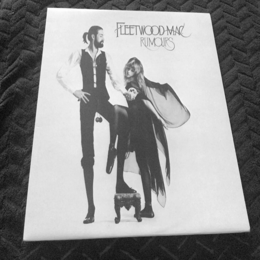

Distance from original: 0.31283962996845904


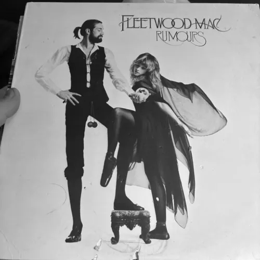

Distance from original: 0.31431437514558347


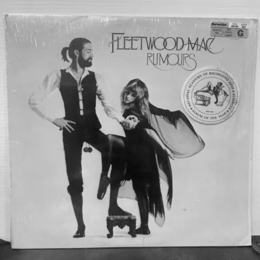

Distance from original: 0.31846351718459043


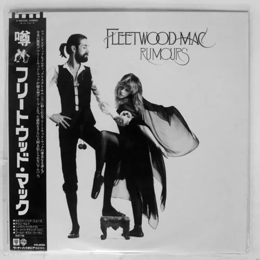

Distance from original: 0.3257476058015253


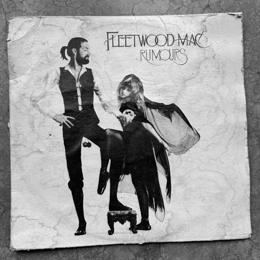

Distance from original: 0.3501202610029027


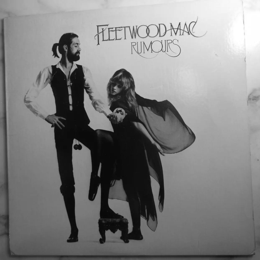

Distance from original: 0.353414258203809


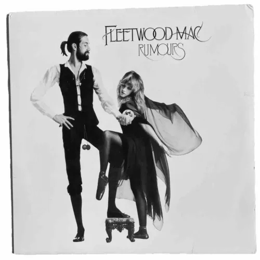

Distance from original: 0.3561338944160215


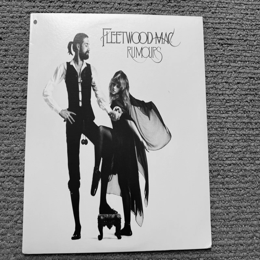

Distance from original: 0.3691516432402736


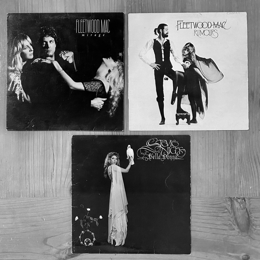

Distance from original: 0.3770875925056145


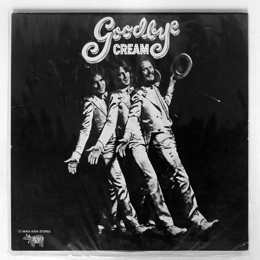

Distance from original: 0.4038157091214799


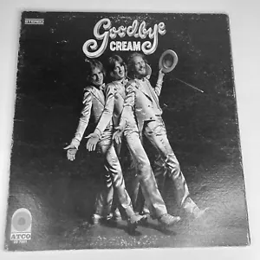

Distance from original: 0.408437775200317


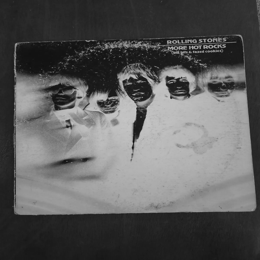

Distance from original: 0.42960382518744367


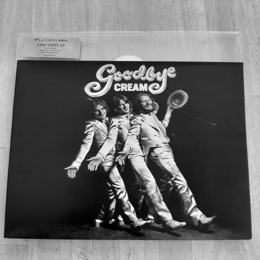

Distance from original: 0.4312775280611387


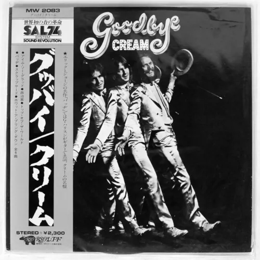

Distance from original: 0.4352167813345954


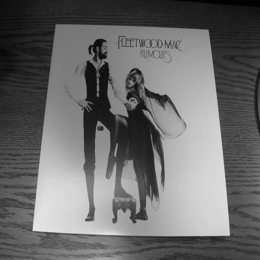

Distance from original: 0.4460698477240067


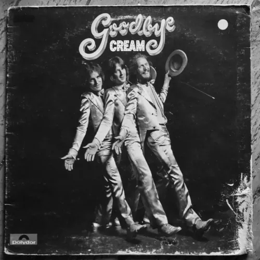

Distance from original: 0.45834237804476374


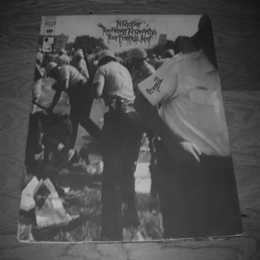

Distance from original: 0.46170614777600316


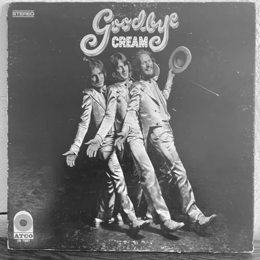

Distance from original: 0.46273365527053967


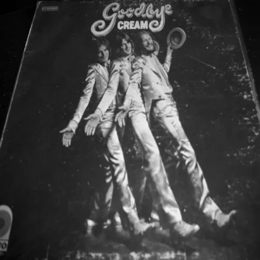

Distance from original: 0.4664782652254379


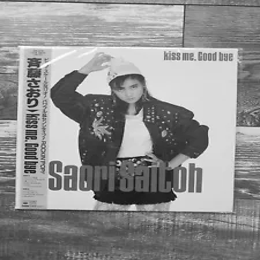

Distance from original: 0.46978439732709343


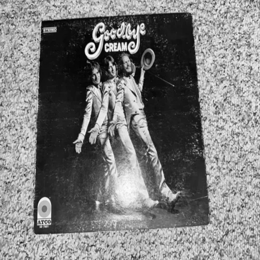

Distance from original: 0.4703263633364131


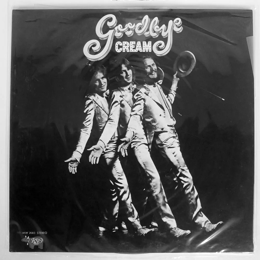

Distance from original: 0.4731726388384576


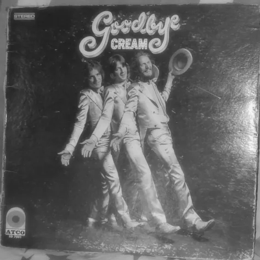

Distance from original: 0.47416838285974405


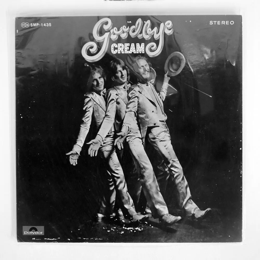

Distance from original: 0.4749197014092347


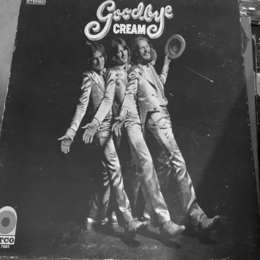

Distance from original: 0.47613534233799903


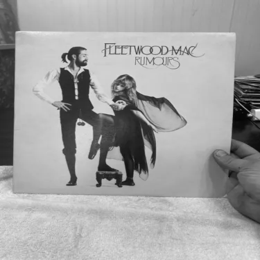

Distance from original: 0.4766437836880396


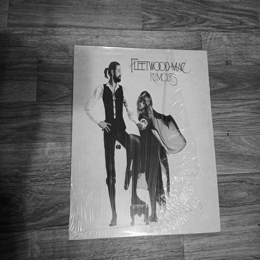

Distance from original: 0.4769335527216837


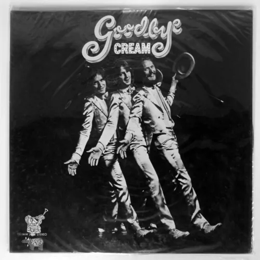

Distance from original: 0.4770985950972926


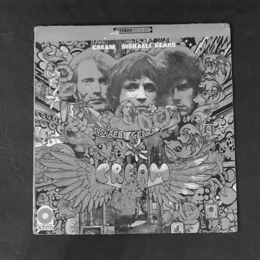

Distance from original: 0.4791940053082465


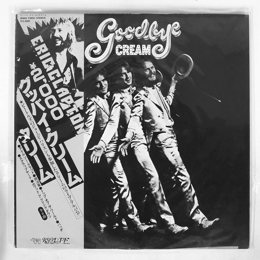

Distance from original: 0.48655417970423676


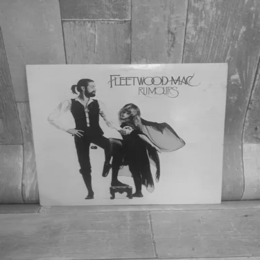

Distance from original: 0.4903681513284516


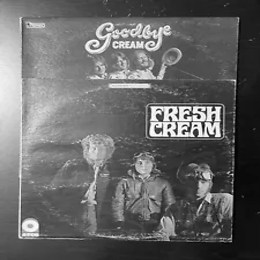

Distance from original: 0.49057834413523016


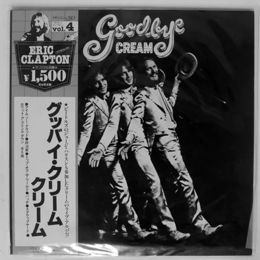

Distance from original: 0.4909381781121299


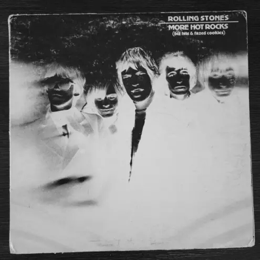

Distance from original: 0.4994670946849542


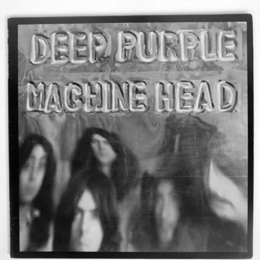

Distance from original: 0.502169514706635


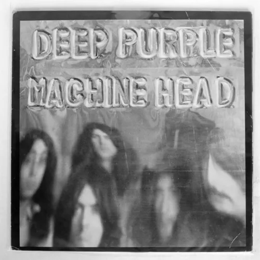

Distance from original: 0.506916558279084


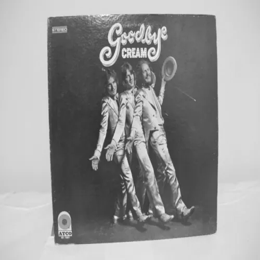

Distance from original: 0.506937356017003


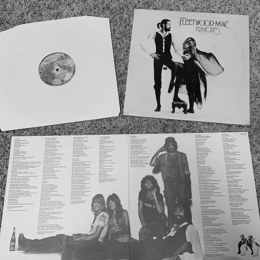

Distance from original: 0.5090620469540622


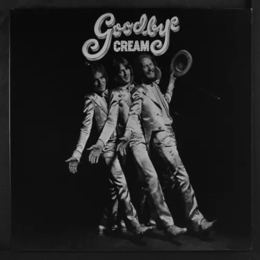

Distance from original: 0.5092434406532953


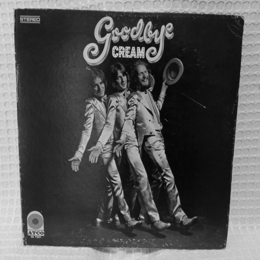

Distance from original: 0.5094892841919287


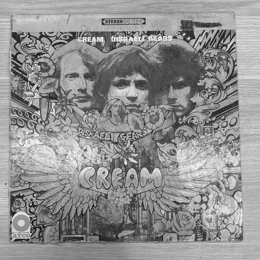

Distance from original: 0.5121239366149555


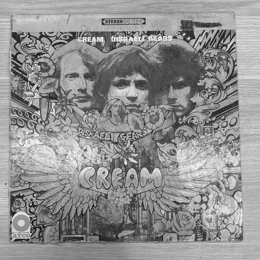

Distance from original: 0.5121239366149555


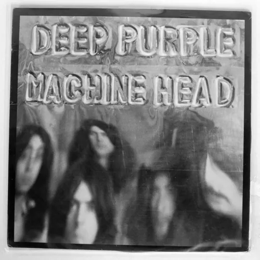

Distance from original: 0.5133751615127038


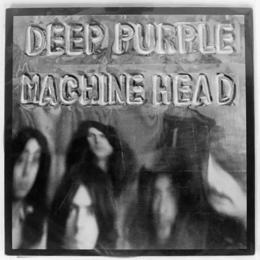

Distance from original: 0.5149133103373744


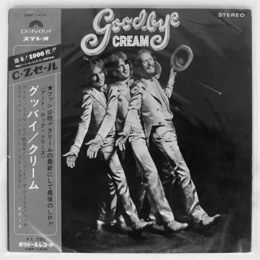

Distance from original: 0.5153618303769276


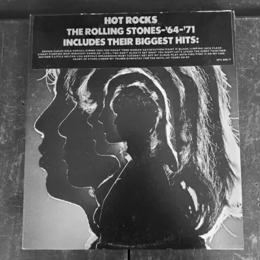

Distance from original: 0.5163073896185175


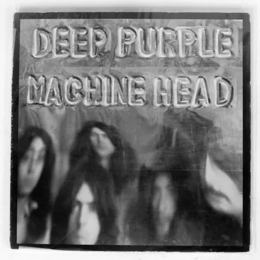

Distance from original: 0.516766795619217


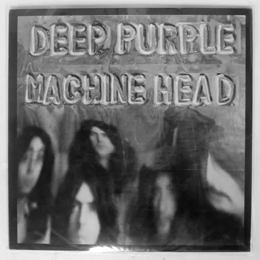

Distance from original: 0.520879790400819


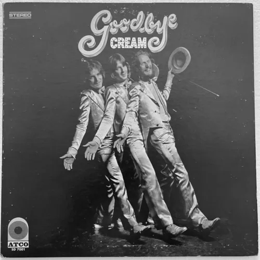

Distance from original: 0.5216292290535648


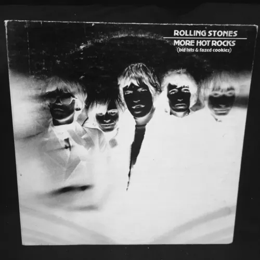

Distance from original: 0.5227360903563855


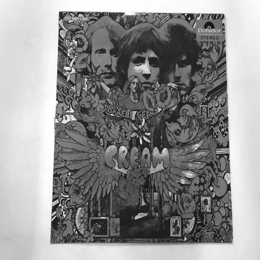

Distance from original: 0.5238808497481371


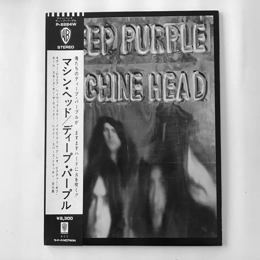

Distance from original: 0.5242239975092365


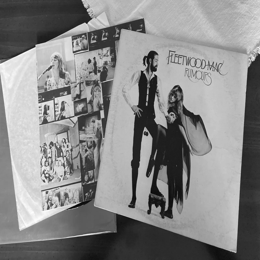

Distance from original: 0.524497090675279


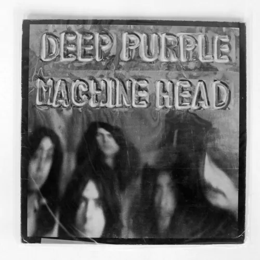

Distance from original: 0.5249588059680894


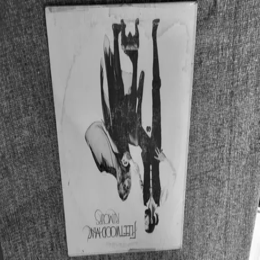

Distance from original: 0.5260714104920223


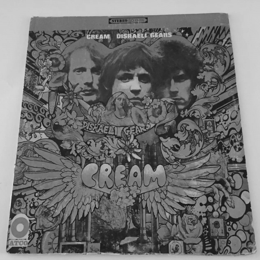

Distance from original: 0.5266017308287569


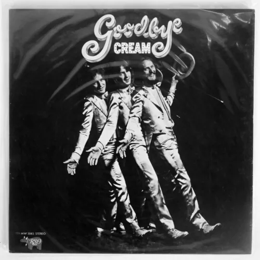

Distance from original: 0.5270679449538209


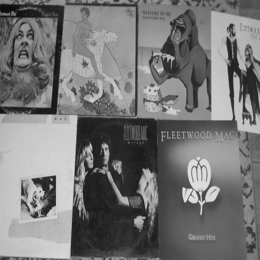

Distance from original: 0.5275327894450959


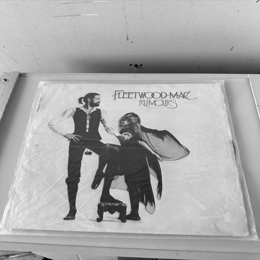

Distance from original: 0.5278603720835706


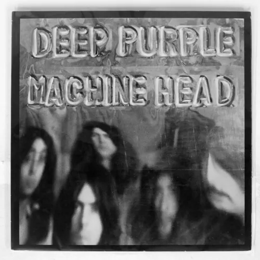

Distance from original: 0.5280550302264759


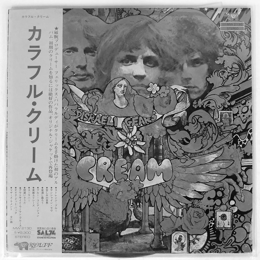

Distance from original: 0.5288036667635891


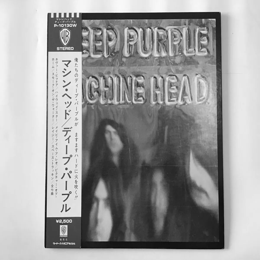

Distance from original: 0.5291135676615912


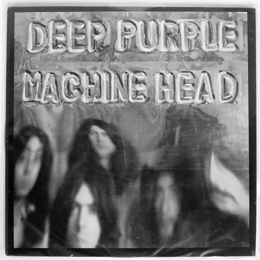

Distance from original: 0.5308922957440085


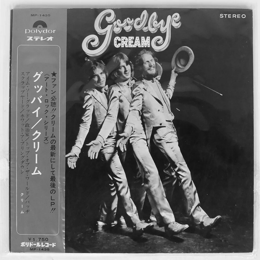

Distance from original: 0.5392060164312528


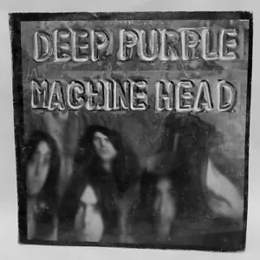

Distance from original: 0.5392438824693377


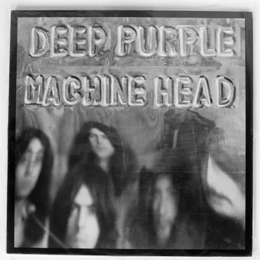

Distance from original: 0.540256379984825


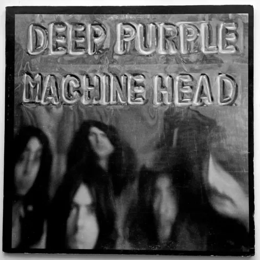

Distance from original: 0.5439499664792791


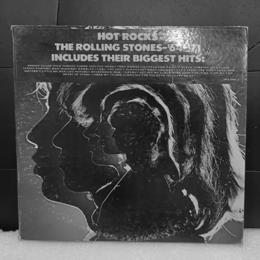

Distance from original: 0.544290831289038


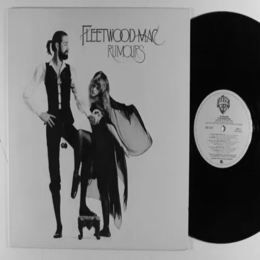

Distance from original: 0.5443245619336075


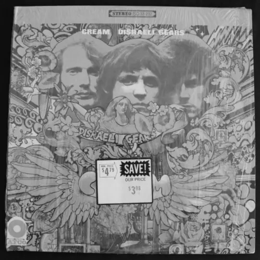

Distance from original: 0.5446405892573072


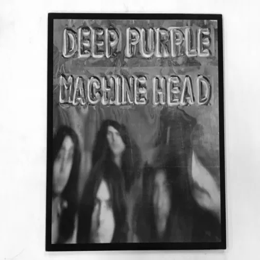

Distance from original: 0.5471535152258176


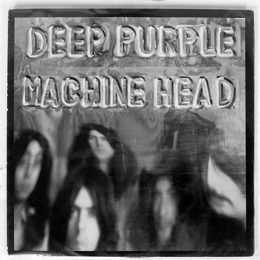

Distance from original: 0.5472028230829693


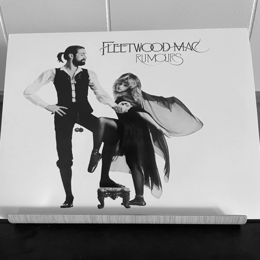

Distance from original: 0.5488246487240369


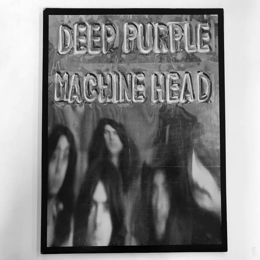

Distance from original: 0.5502699321837003


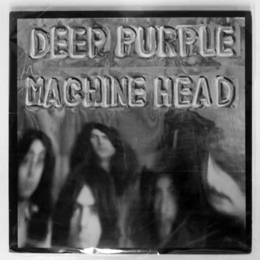

Distance from original: 0.5506304747654114


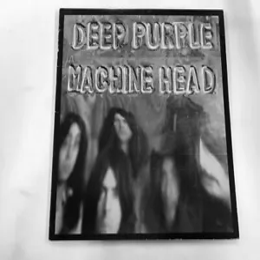

Distance from original: 0.5514117508548575


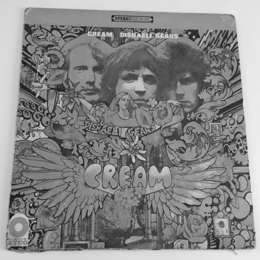

Distance from original: 0.5521906764657869


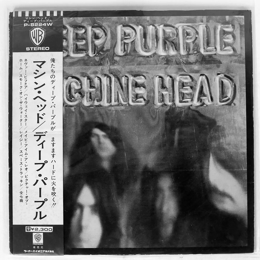

Distance from original: 0.5529410187144317


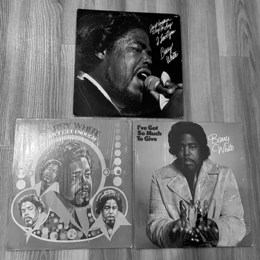

Distance from original: 0.5529445104138587


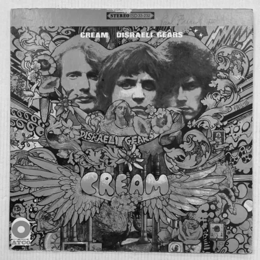

Distance from original: 0.5549339359170629


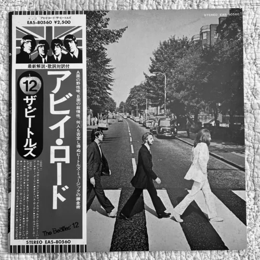

Distance from original: 0.5549734133676669


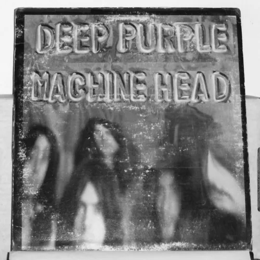

Distance from original: 0.555110349460832


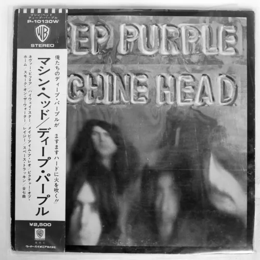

Distance from original: 0.5564970742111319


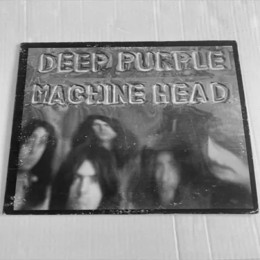

Distance from original: 0.557329229222757


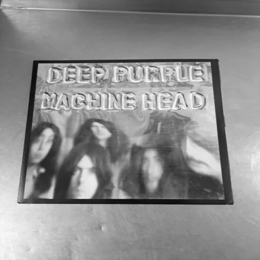

Distance from original: 0.5580143526658862


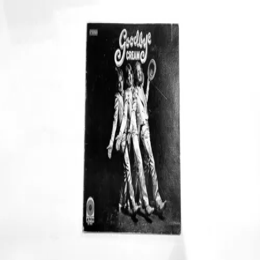

Distance from original: 0.5581651692157559


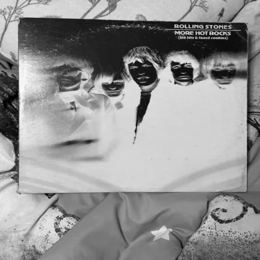

Distance from original: 0.5584173294045154


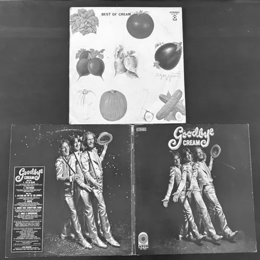

Distance from original: 0.5594951499344647


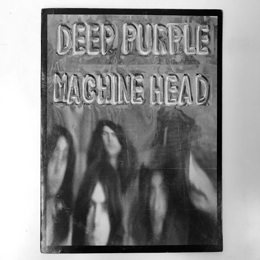

Distance from original: 0.5601388874806144


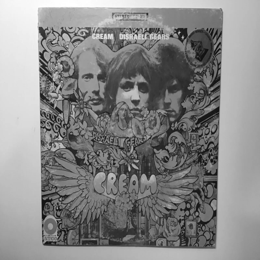

Distance from original: 0.5614328538346656


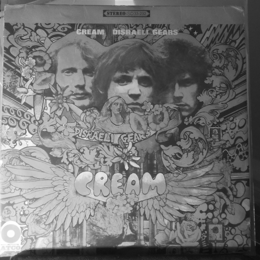

Distance from original: 0.5614564823767119


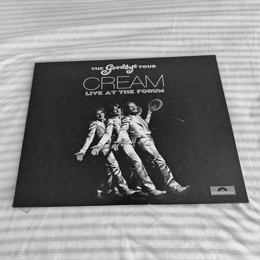

Distance from original: 0.5620647433321366


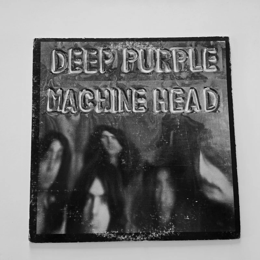

Distance from original: 0.5626226371567237


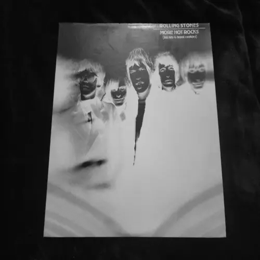

Distance from original: 0.5636052245148311


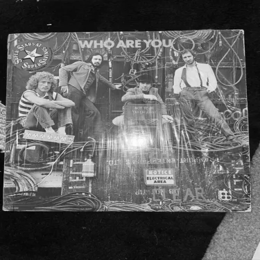

Distance from original: 0.5636488092034081


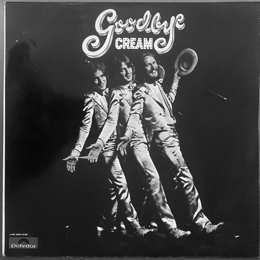

Distance from original: 0.5648108147182103


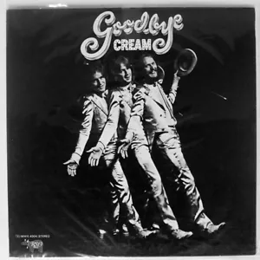

Distance from original: 0.5669965313096366


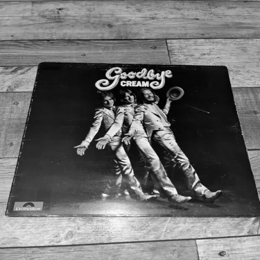

Distance from original: 0.572398983809604


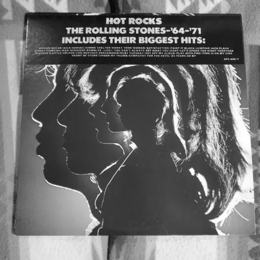

Distance from original: 0.5724013662279147


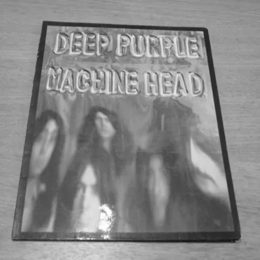

Distance from original: 0.5733882603399496


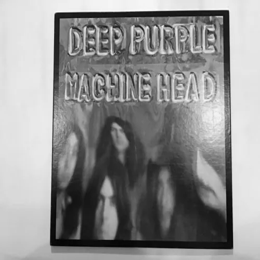

Distance from original: 0.5753057737645816


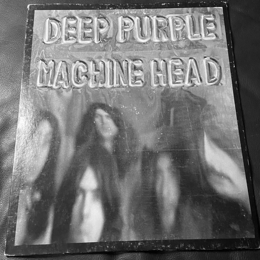

Distance from original: 0.5789021930474982


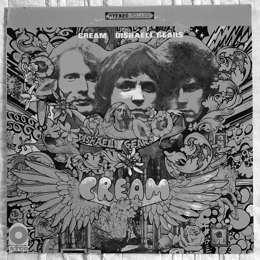

Distance from original: 0.5797805464944201


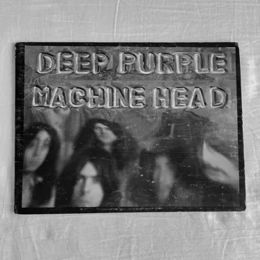

Distance from original: 0.580636392616169


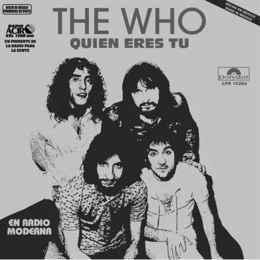

Distance from original: 0.5811757661911878


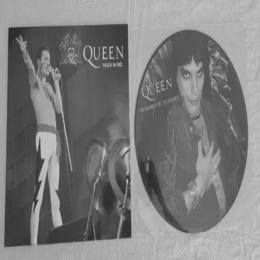

Distance from original: 0.5865842151484736


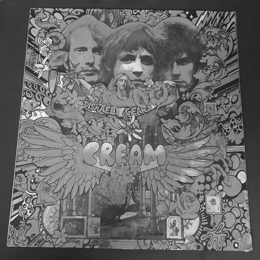

Distance from original: 0.5880641101937345


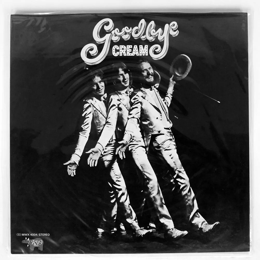

Distance from original: 0.5922134482464176


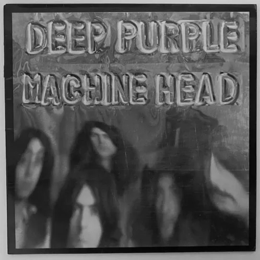

Distance from original: 0.5929244782236069


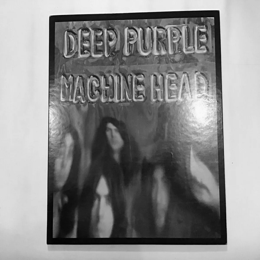

Distance from original: 0.5938577316046469


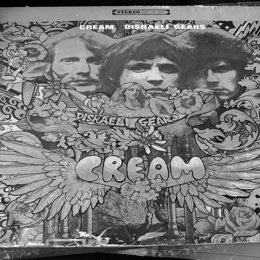

Distance from original: 0.5940666952420081


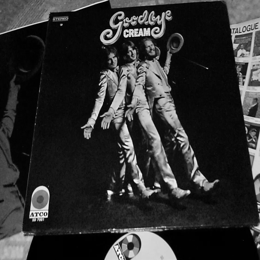

Distance from original: 0.5942847989853155


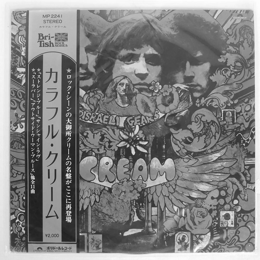

Distance from original: 0.5965373555410658


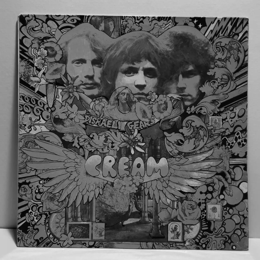

Distance from original: 0.5993976379187584


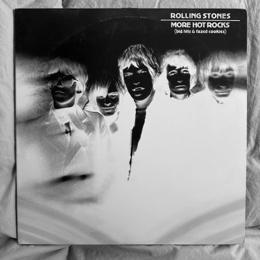

Distance from original: 0.6000474361043374


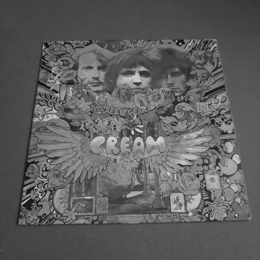

Distance from original: 0.6025239824601409


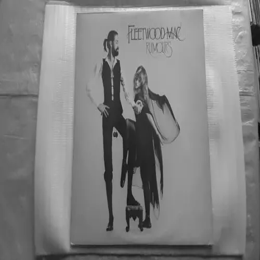

Distance from original: 0.602760440038477


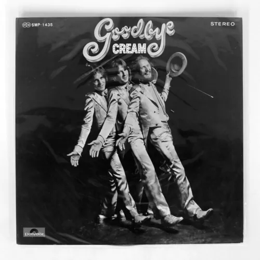

Distance from original: 0.6045876286665626


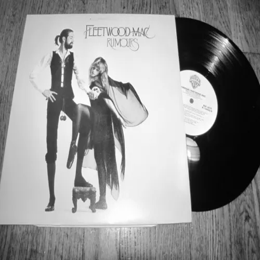

Distance from original: 0.6047007169460719


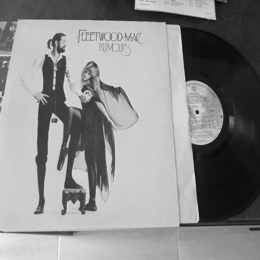

Distance from original: 0.6058247102964642


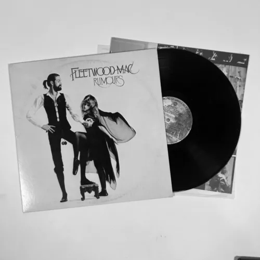

Distance from original: 0.6093956509438585


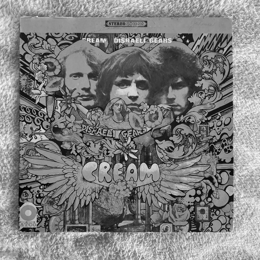

Distance from original: 0.6106278231260467


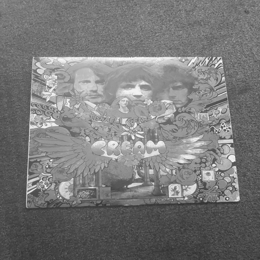

Distance from original: 0.6116576045946703


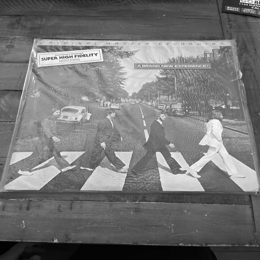

Distance from original: 0.6119040935988607


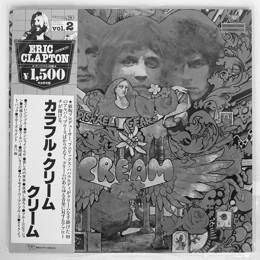

Distance from original: 0.6145397619138283


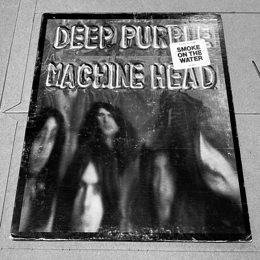

Distance from original: 0.6155288318982008


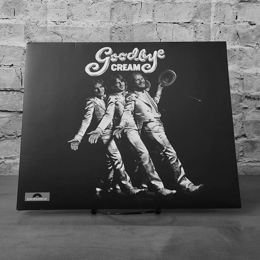

Distance from original: 0.6171014536831269


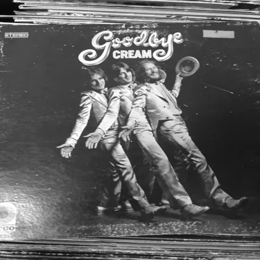

Distance from original: 0.6177376726044435


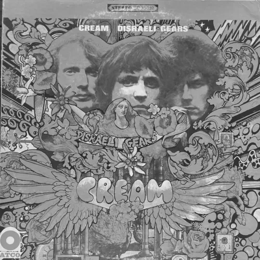

Distance from original: 0.6188775328175867


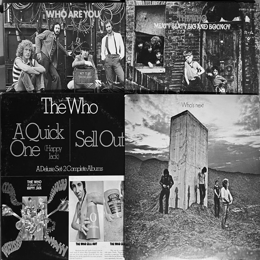

Distance from original: 0.6195822419680257


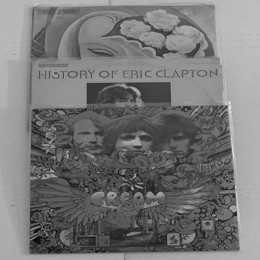

Distance from original: 0.6208355521019522


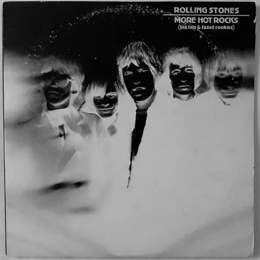

Distance from original: 0.6208842757842972


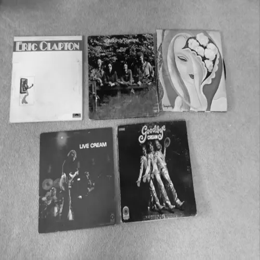

Distance from original: 0.6212331146708245


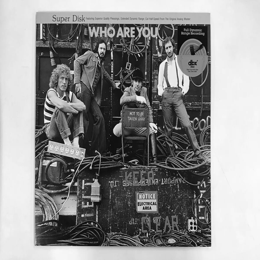

Distance from original: 0.6232759016765692


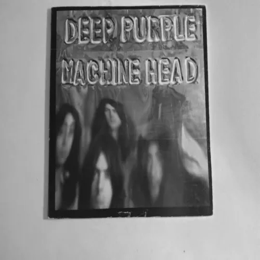

Distance from original: 0.624455167493172


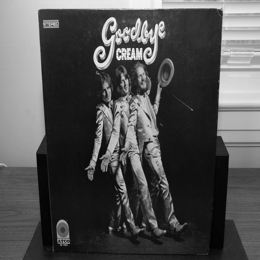

Distance from original: 0.6247538852676198


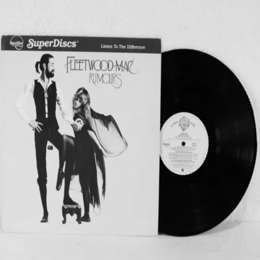

Distance from original: 0.6253507891161294


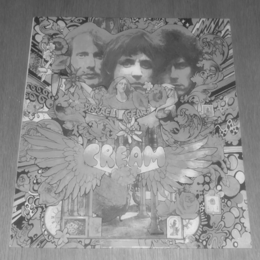

Distance from original: 0.6279560729924862


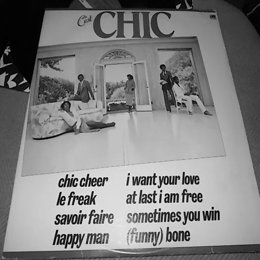

Distance from original: 0.6307357298091192


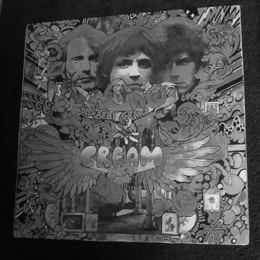

Distance from original: 0.6310268297913512


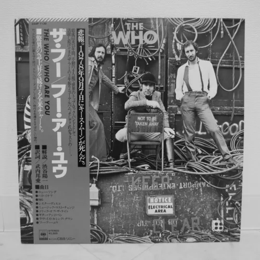

Distance from original: 0.6326628166151154


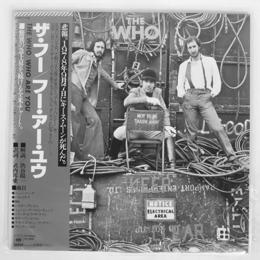

Distance from original: 0.6345644129410085


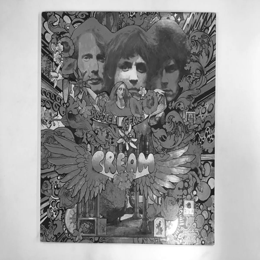

Distance from original: 0.6373447320821882


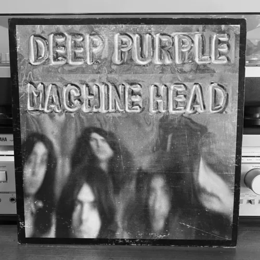

Distance from original: 0.6393660306205313


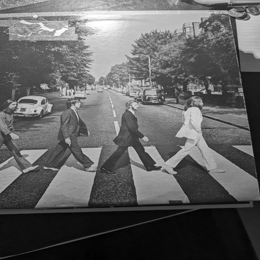

Distance from original: 0.6403003656720653


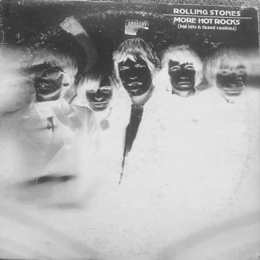

Distance from original: 0.6404154851275305


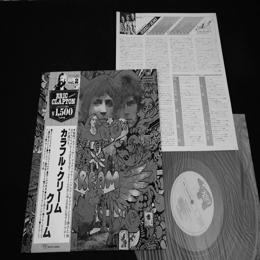

Distance from original: 0.6412273383807618


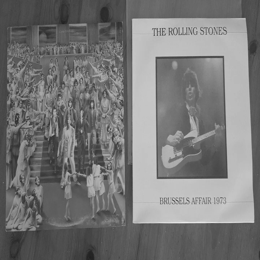

Distance from original: 0.6428419718077768


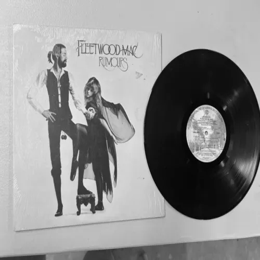

Distance from original: 0.6436549433138143


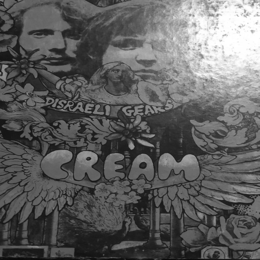

Distance from original: 0.6462959107084307


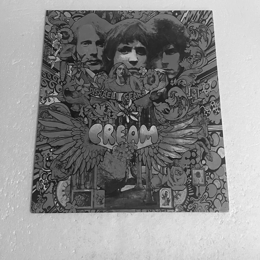

Distance from original: 0.6495818082478698


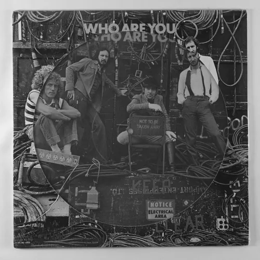

Distance from original: 0.6496129265832062


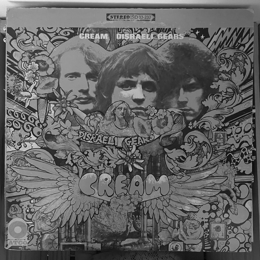

Distance from original: 0.6496971342282052


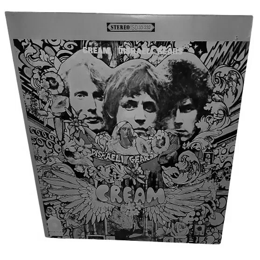

Distance from original: 0.6508755359008739


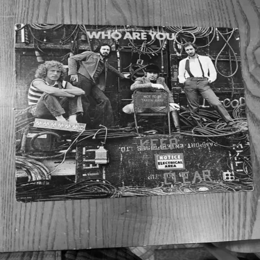

Distance from original: 0.652713395863692


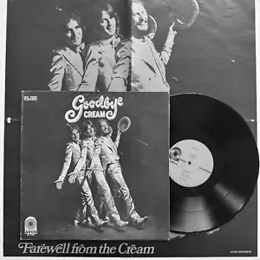

Distance from original: 0.6550960182383805


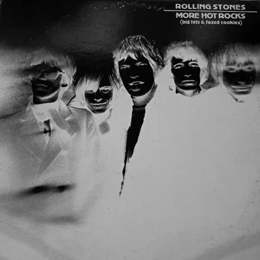

Distance from original: 0.6563907698913204


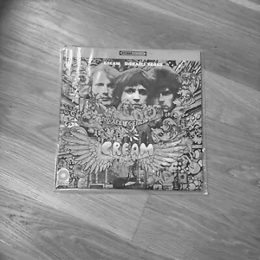

Distance from original: 0.6565881084751399


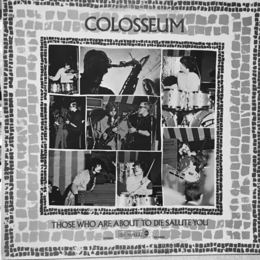

Distance from original: 0.6599990116452903


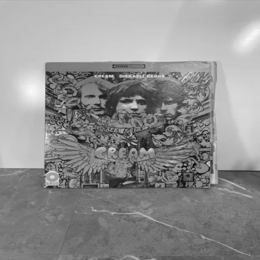

Distance from original: 0.6603859015338724


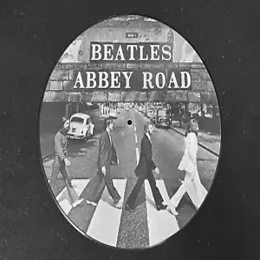

Distance from original: 0.6607981592167398


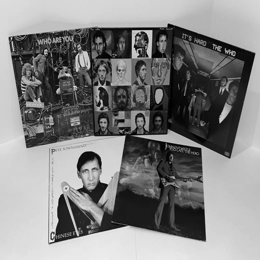

Distance from original: 0.6611937947493105


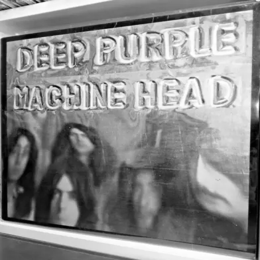

Distance from original: 0.6621529627585475


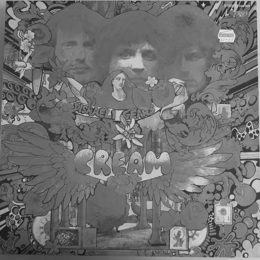

Distance from original: 0.6633432144629675


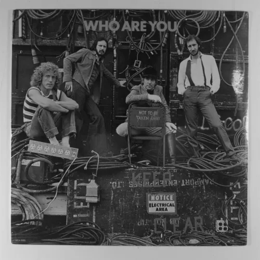

Distance from original: 0.6677986762563718


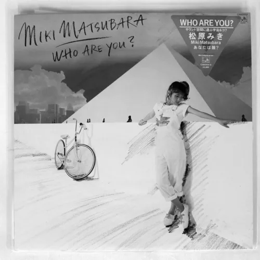

Distance from original: 0.6681640226083605


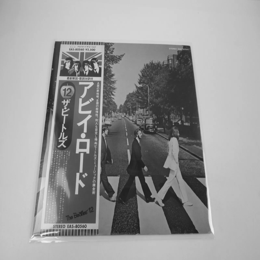

Distance from original: 0.6681641904780291


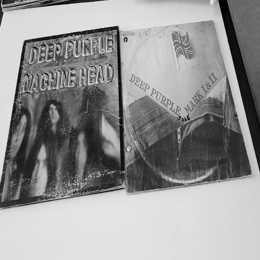

Distance from original: 0.6692216915353231


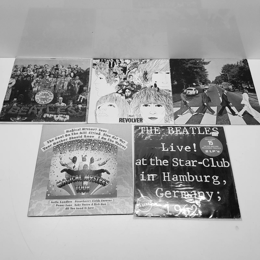

Distance from original: 0.6697881257110885


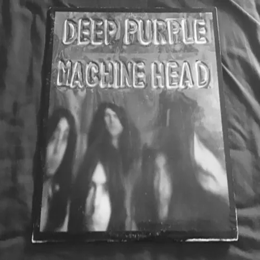

Distance from original: 0.6702761317839326


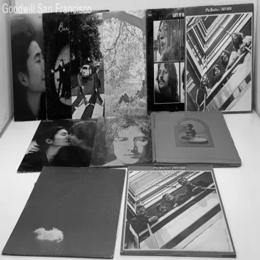

Distance from original: 0.6713909510935715


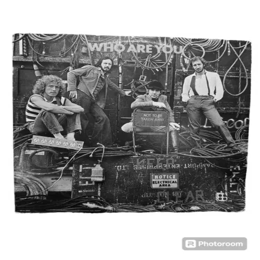

Distance from original: 0.6715651331456758


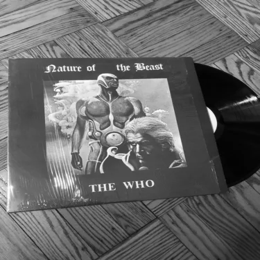

Distance from original: 0.6721415664416772


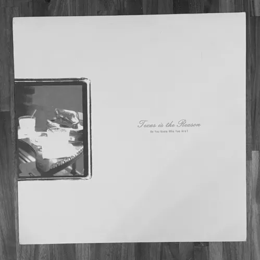

Distance from original: 0.6722216698665309


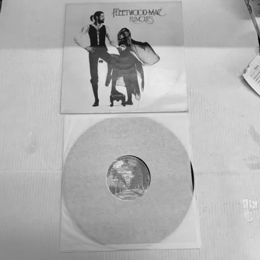

Distance from original: 0.673403342922339


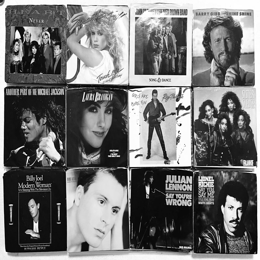

Distance from original: 0.6736562422959809


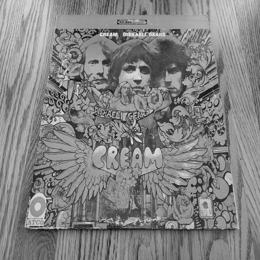

Distance from original: 0.674296258547457


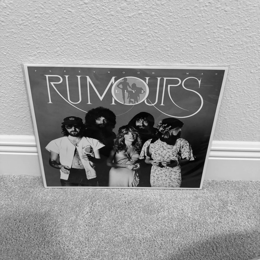

Distance from original: 0.6758988945835223


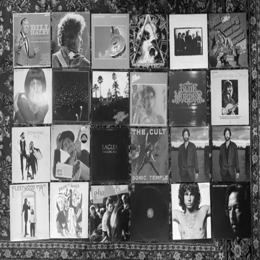

Distance from original: 0.6764867451712712


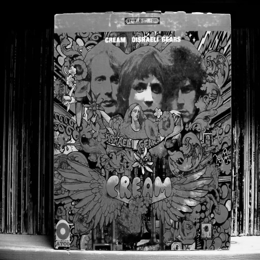

Distance from original: 0.6807465312597498


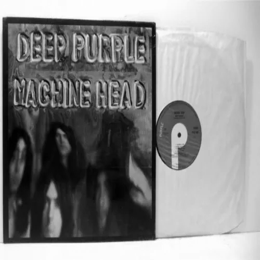

Distance from original: 0.6826540347195951


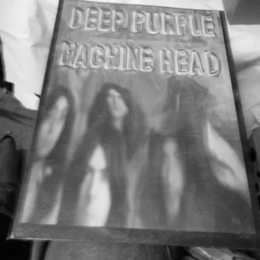

Distance from original: 0.6837515459683565


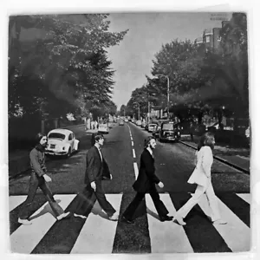

Distance from original: 0.6843838263132449


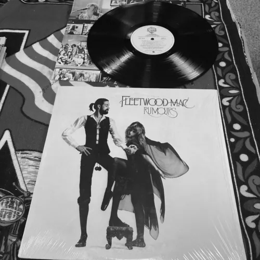

Distance from original: 0.6846552520015498


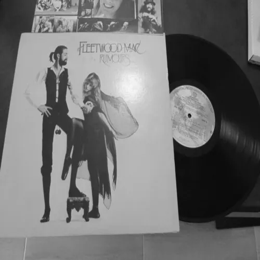

Distance from original: 0.6846805361695458


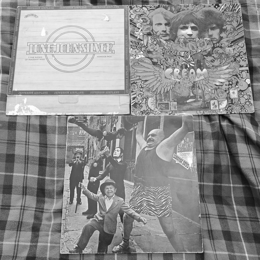

Distance from original: 0.6854966734996607


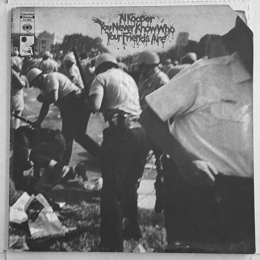

Distance from original: 0.6864533967861135


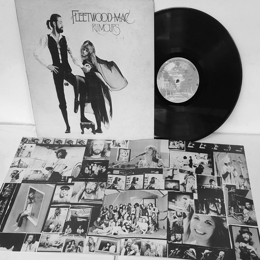

Distance from original: 0.6891271217956683


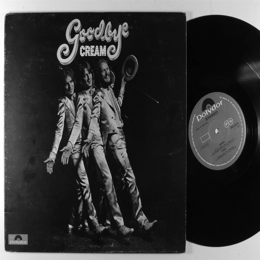

Distance from original: 0.6895474593687603


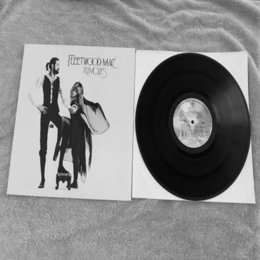

Distance from original: 0.6900874474983834


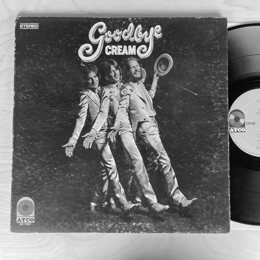

Distance from original: 0.6906235120063189


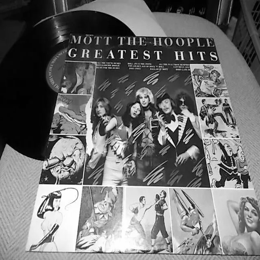

Distance from original: 0.690981115202138


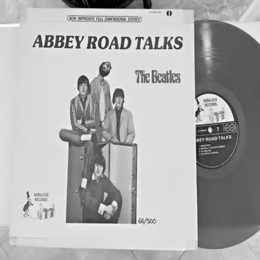

Distance from original: 0.6915418867924231


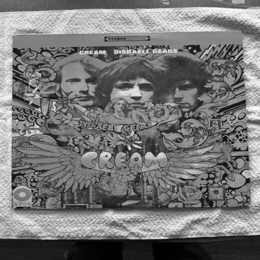

Distance from original: 0.6934918950592852


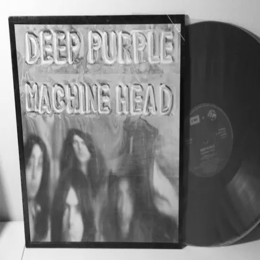

Distance from original: 0.6945090195279255


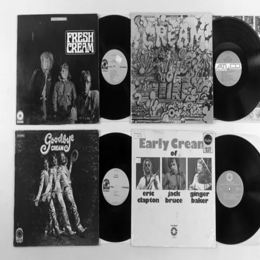

Distance from original: 0.696398843330526


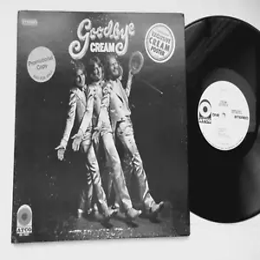

Distance from original: 0.6973529645447618


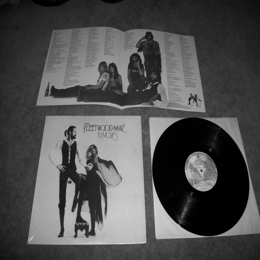

Distance from original: 0.6986655907691499


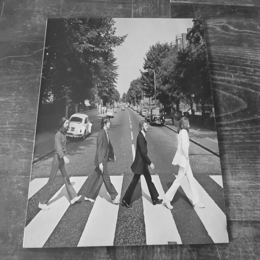

Distance from original: 0.699454282120857


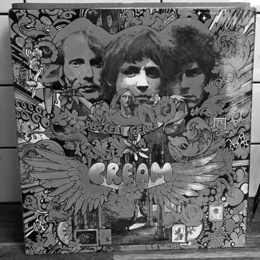

Distance from original: 0.6997564079084945


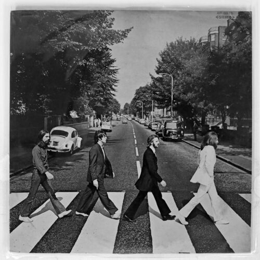

Distance from original: 0.7003807780770026


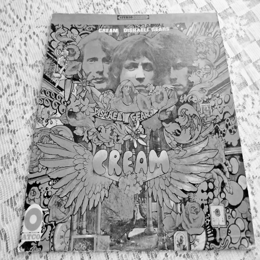

Distance from original: 0.7007133783441897


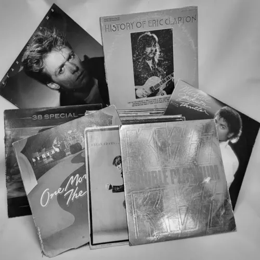

Distance from original: 0.701283767355392


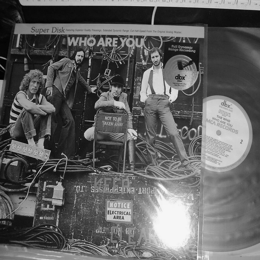

Distance from original: 0.7040288789933251


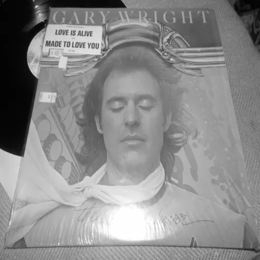

Distance from original: 0.7053071507755732


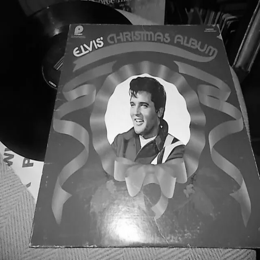

Distance from original: 0.70673622039406


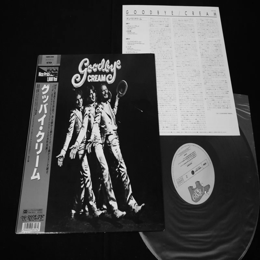

Distance from original: 0.7074242618222402


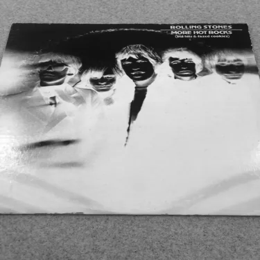

Distance from original: 0.7084377230417984


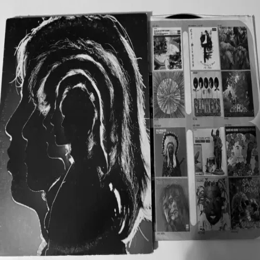

Distance from original: 0.708909677372365


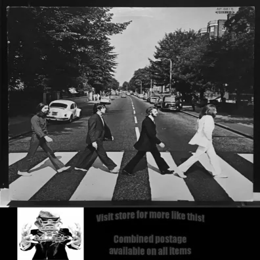

Distance from original: 0.7100373726038679


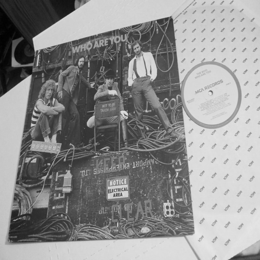

Distance from original: 0.7105945190081215


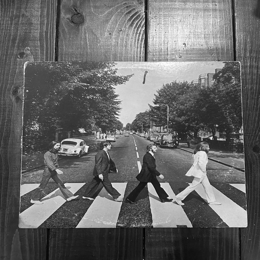

Distance from original: 0.7111427583987373


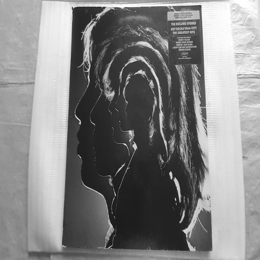

Distance from original: 0.7203982826238466


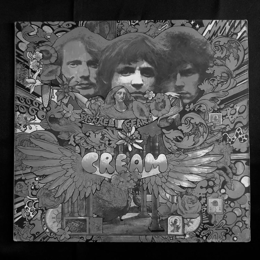

Distance from original: 0.7213981010441448


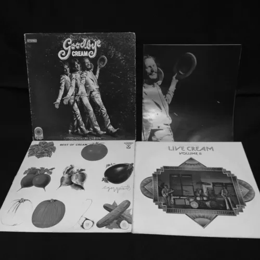

Distance from original: 0.725233268979512


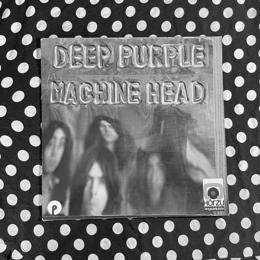

Distance from original: 0.7279551247570365


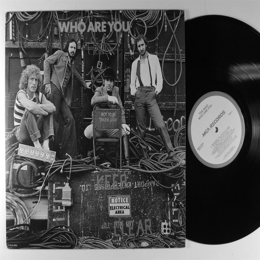

Distance from original: 0.7285147465689146


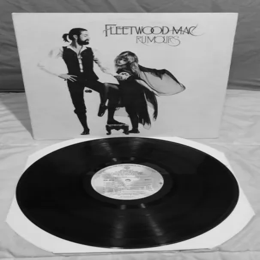

Distance from original: 0.7295435529747475


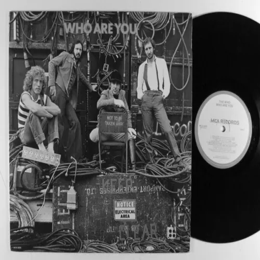

Distance from original: 0.7300651239834269


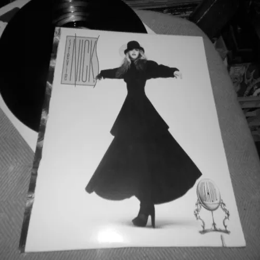

Distance from original: 0.7312105539969872


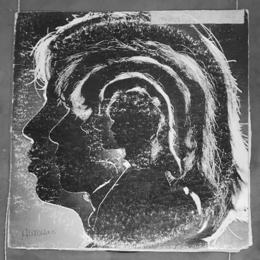

Distance from original: 0.7334232694151505


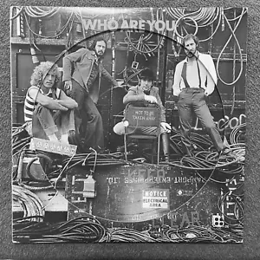

Distance from original: 0.7336615750842623


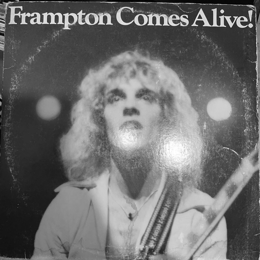

Distance from original: 0.7353201744810332


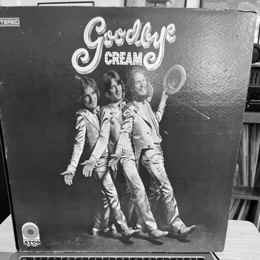

Distance from original: 0.7357539396919526


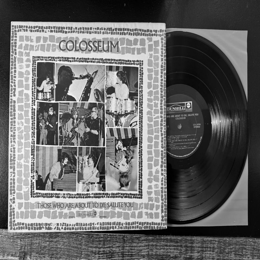

Distance from original: 0.7357873372224255


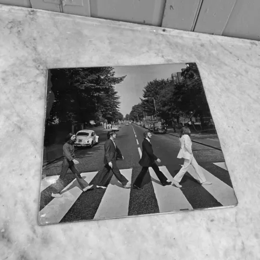

Distance from original: 0.7370353094029665


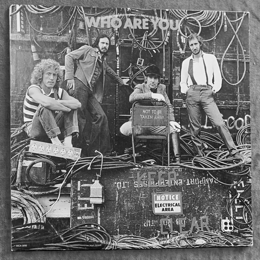

Distance from original: 0.7373231140241665


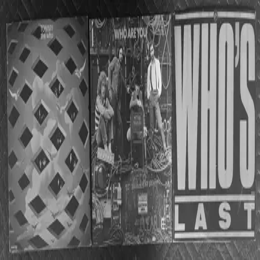

Distance from original: 0.7387844621145347


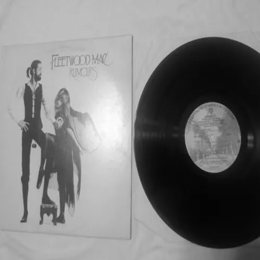

Distance from original: 0.7405292928036442


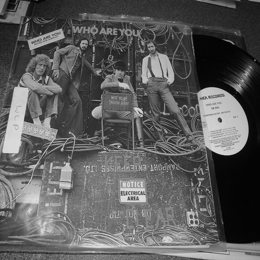

Distance from original: 0.7421318049326252


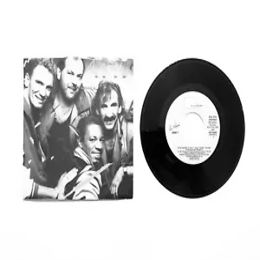

Distance from original: 0.7422075981493472


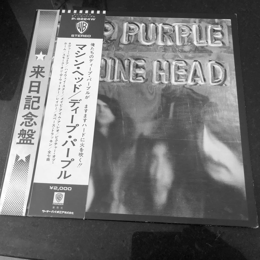

Distance from original: 0.7429207533204307


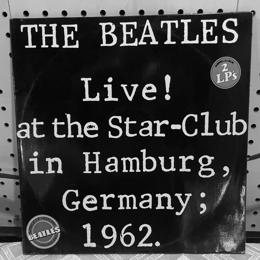

Distance from original: 0.7437926354895549


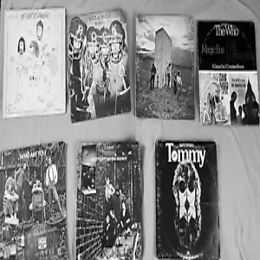

Distance from original: 0.7440309398565803


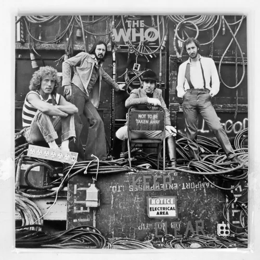

Distance from original: 0.744449657536645


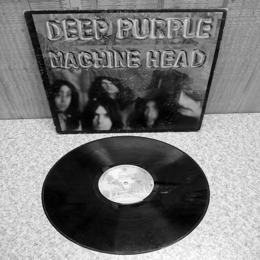

Distance from original: 0.7445564492067602


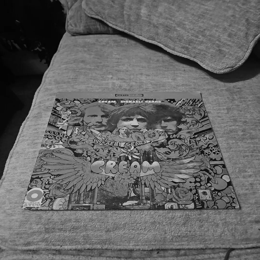

Distance from original: 0.7449619629939752


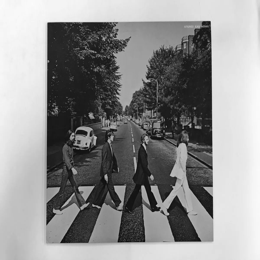

Distance from original: 0.7451250061219794


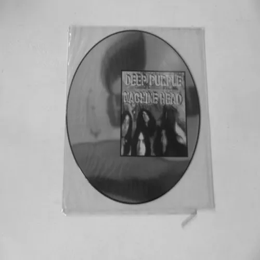

Distance from original: 0.746030865691093


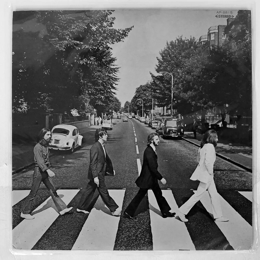

Distance from original: 0.7514453597153326


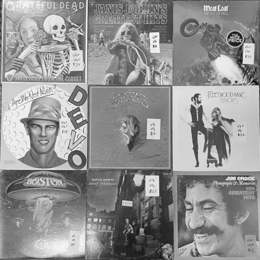

Distance from original: 0.7518288931487025


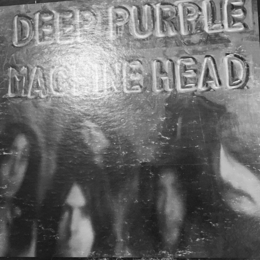

Distance from original: 0.7520475713910942


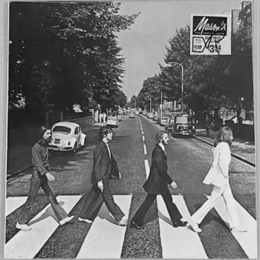

Distance from original: 0.7521855539045004


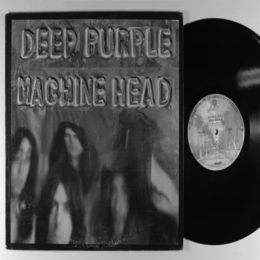

Distance from original: 0.7533028744100831


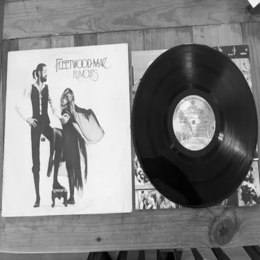

Distance from original: 0.7534951561645882


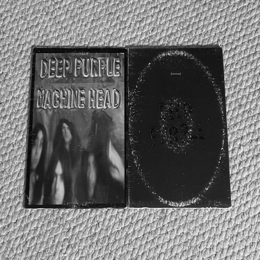

Distance from original: 0.7556593569178743


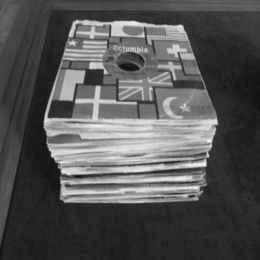

Distance from original: 0.7570876434192757


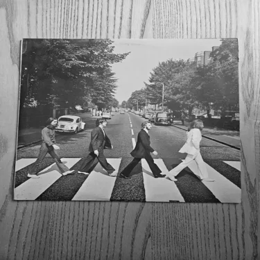

Distance from original: 0.7571096010185538


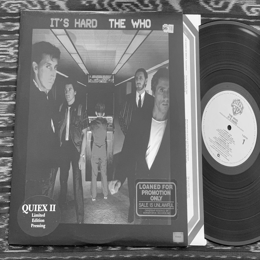

Distance from original: 0.7577247908190827


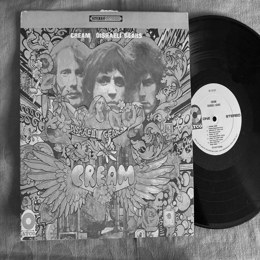

Distance from original: 0.7583674824477256


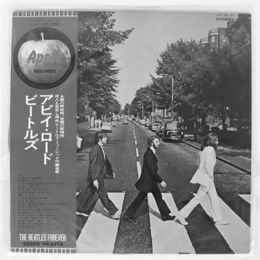

Distance from original: 0.7587098803461046


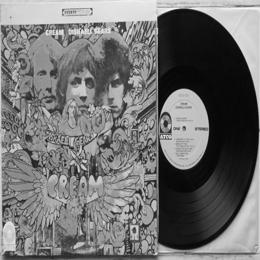

Distance from original: 0.7588387251047406


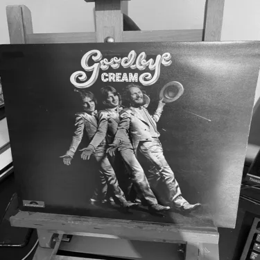

Distance from original: 0.7615274803509038


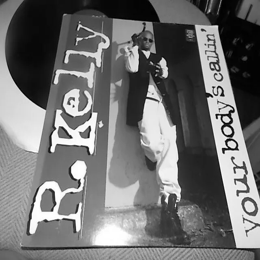

Distance from original: 0.7624160296638975


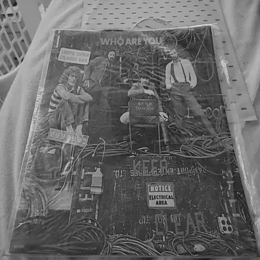

Distance from original: 0.7628061015558542


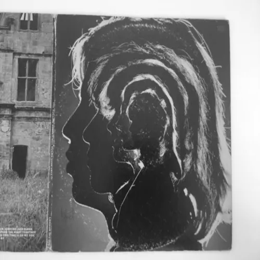

Distance from original: 0.7636223447319684


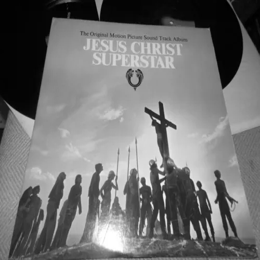

Distance from original: 0.7639175192244261


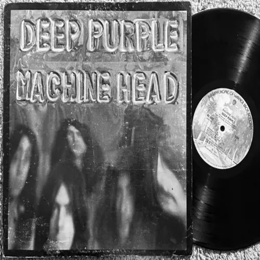

Distance from original: 0.7654428100882301


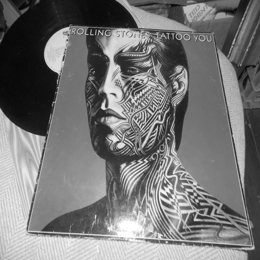

Distance from original: 0.7655367862962315


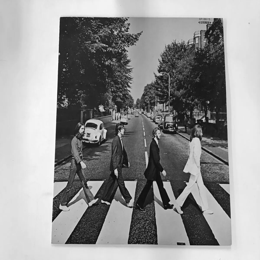

Distance from original: 0.7659130160078258


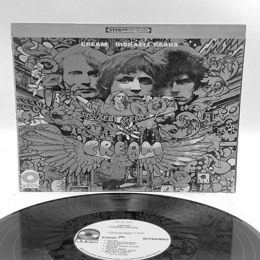

Distance from original: 0.767592936872525


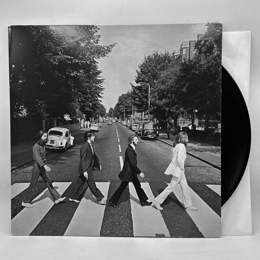

Distance from original: 0.7686293718531348


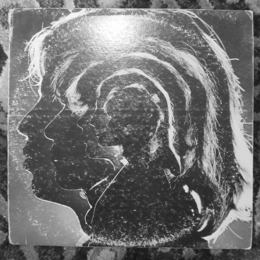

Distance from original: 0.770803491300561


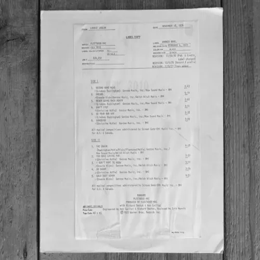

Distance from original: 0.7717131862793202


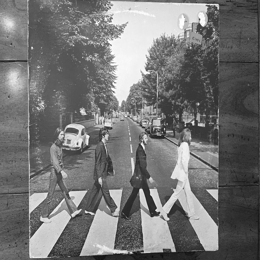

Distance from original: 0.7750624597883167


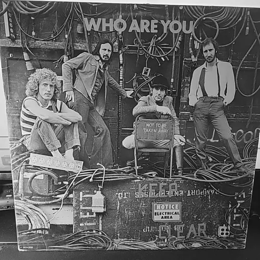

Distance from original: 0.7752419984642166


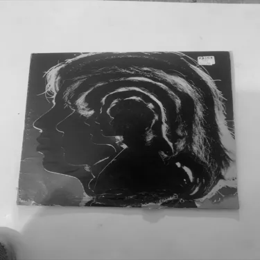

Distance from original: 0.7759754275486141


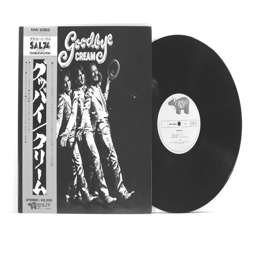

Distance from original: 0.7762240627117276


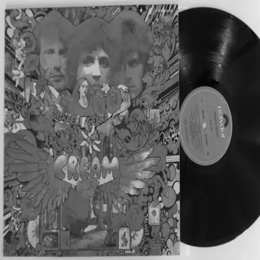

Distance from original: 0.7776041171540166


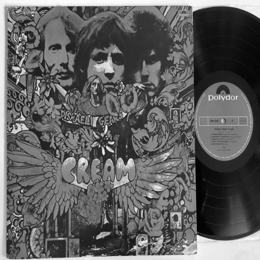

Distance from original: 0.7776677318740467


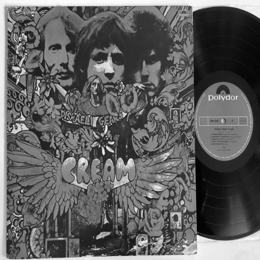

Distance from original: 0.7776677318740467


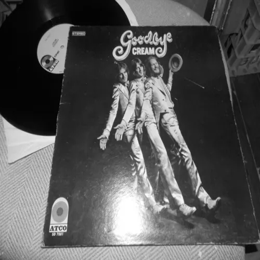

Distance from original: 0.7781449228805751


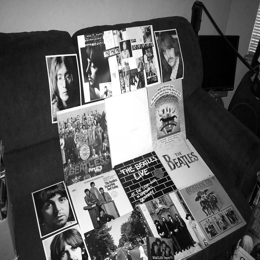

Distance from original: 0.7819751929493126


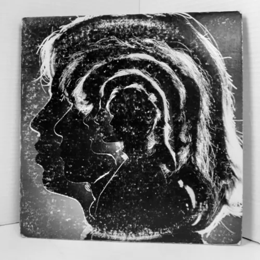

Distance from original: 0.7825431960121294


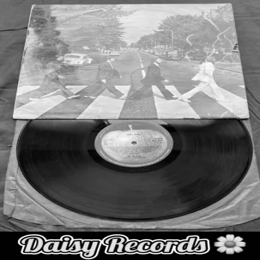

Distance from original: 0.7835640313008813


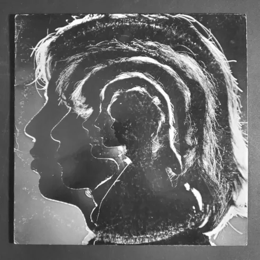

Distance from original: 0.7837475118584037


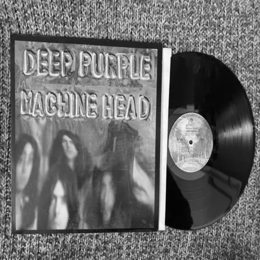

Distance from original: 0.7838018723715842


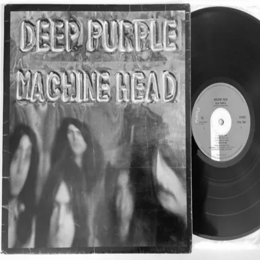

Distance from original: 0.7853765264352203


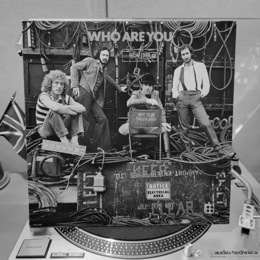

Distance from original: 0.7882047376971133


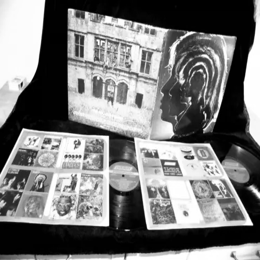

Distance from original: 0.7883852234268975


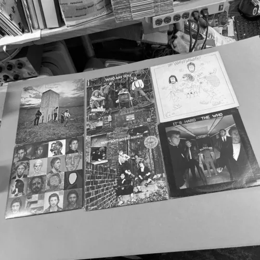

Distance from original: 0.7890248936815174


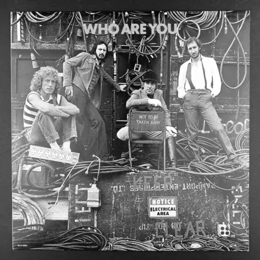

Distance from original: 0.7895363729958907


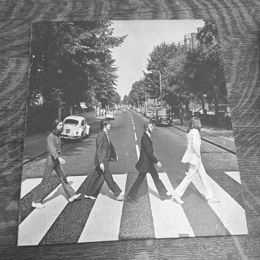

Distance from original: 0.7914010706211636


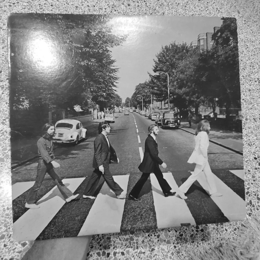

Distance from original: 0.7917273548199151


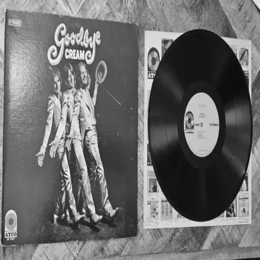

Distance from original: 0.7935683226403893


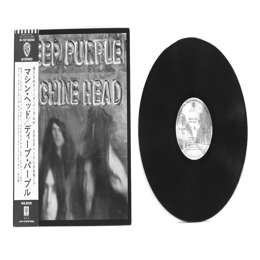

Distance from original: 0.7939796253498916


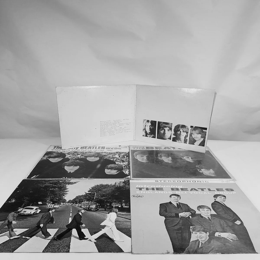

Distance from original: 0.794504014241411


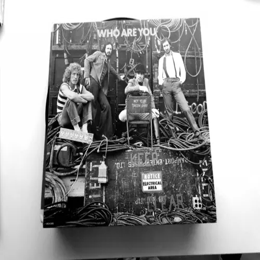

Distance from original: 0.7946110154774189


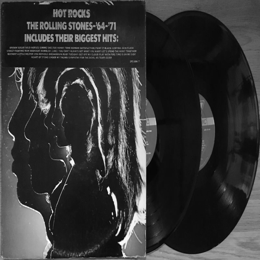

Distance from original: 0.7946149881167692


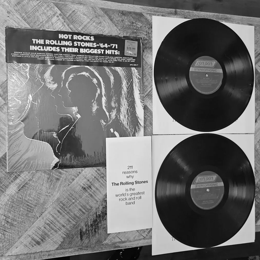

Distance from original: 0.7957940673095325


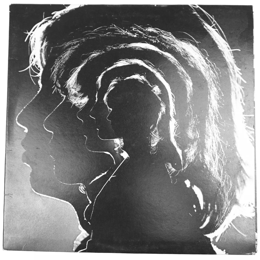

Distance from original: 0.7959730140278622


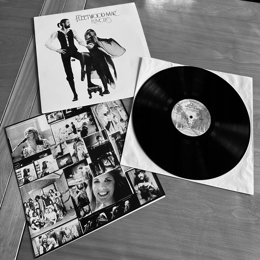

Distance from original: 0.7961904751960294


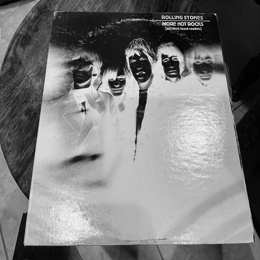

Distance from original: 0.7966199861485053


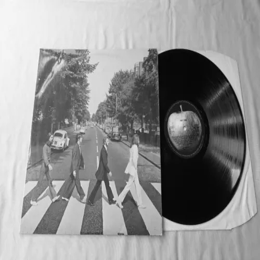

Distance from original: 0.7982205096529227


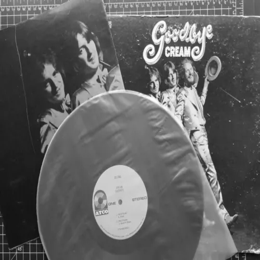

Distance from original: 0.7983481755924409


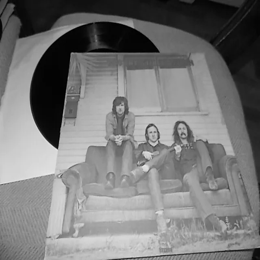

Distance from original: 0.798919731209864


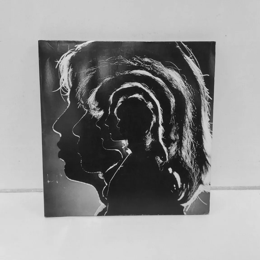

Distance from original: 0.7992541501523714


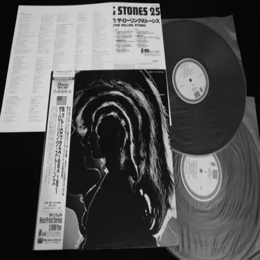

Distance from original: 0.80152046823965


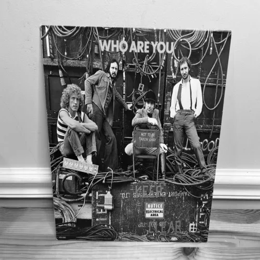

Distance from original: 0.8016343664887536


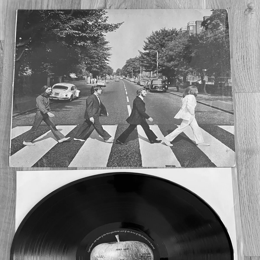

Distance from original: 0.8044791999693659


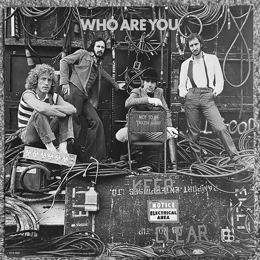

Distance from original: 0.8074451253516757


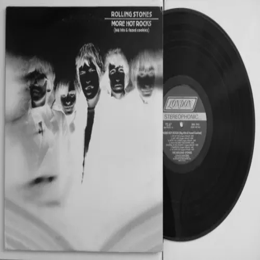

Distance from original: 0.8092623366676676


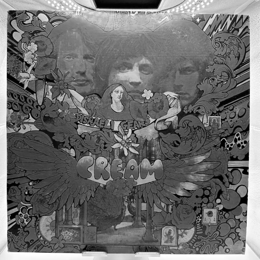

Distance from original: 0.8104890704530043


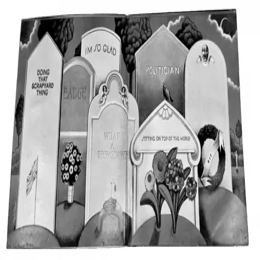

Distance from original: 0.8144674917317698


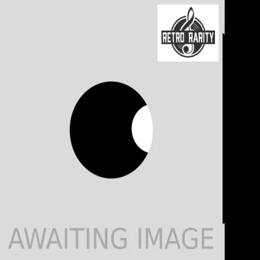

Distance from original: 0.8158098082344822


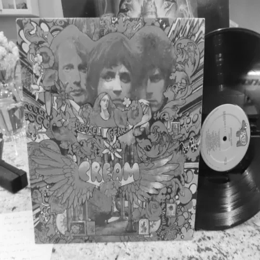

Distance from original: 0.8175874243223165


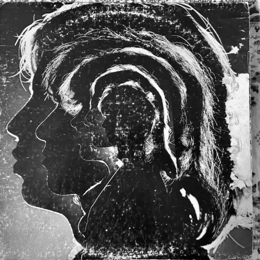

Distance from original: 0.8191551870378657


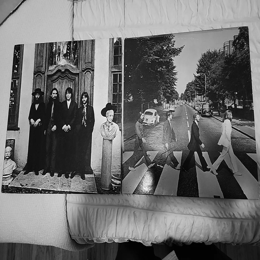

Distance from original: 0.8207699136536353


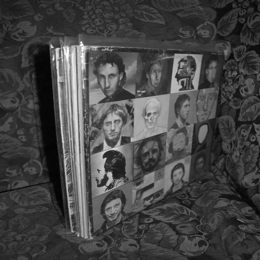

Distance from original: 0.8207710869876359


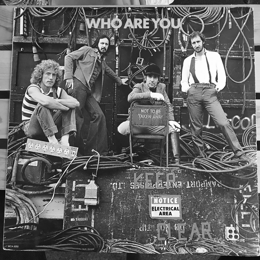

Distance from original: 0.821386705886548


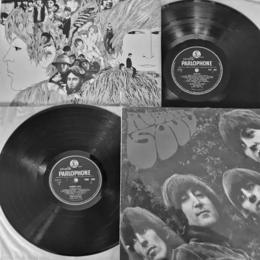

Distance from original: 0.8217624261331227


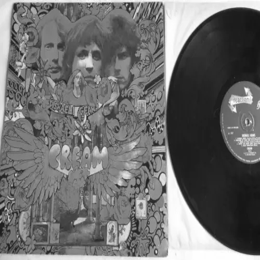

Distance from original: 0.822079253899556


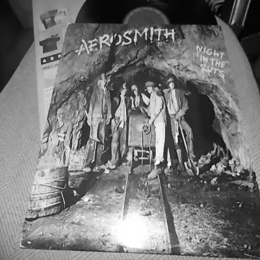

Distance from original: 0.8222038659972825


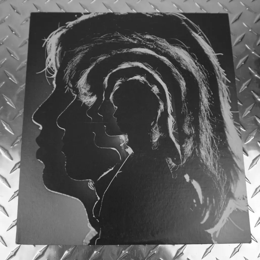

Distance from original: 0.8226273684627599


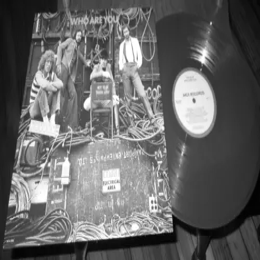

Distance from original: 0.8237438190789032


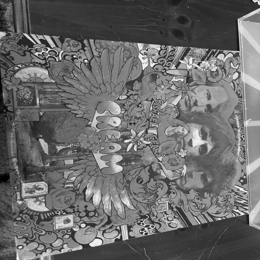

Distance from original: 0.8237854434635982


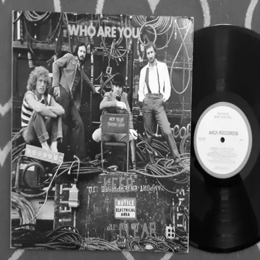

Distance from original: 0.8254779906638245


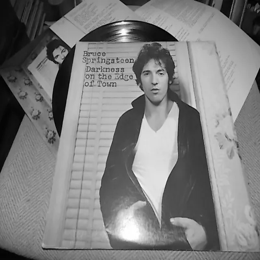

Distance from original: 0.8262944846868732


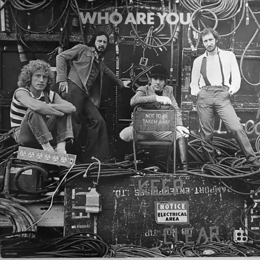

Distance from original: 0.8283800971013772


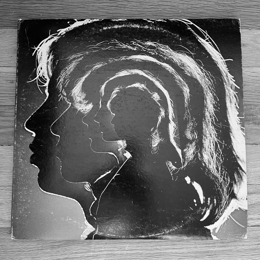

Distance from original: 0.8286444430591191


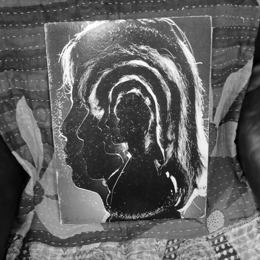

Distance from original: 0.8296132805261965


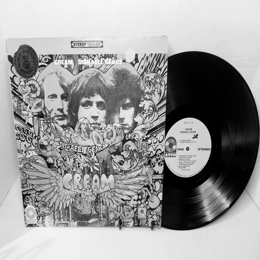

Distance from original: 0.829719866714264


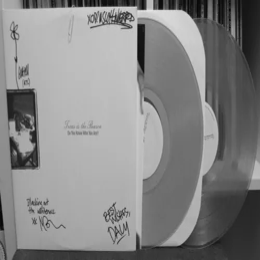

Distance from original: 0.8301303336944302


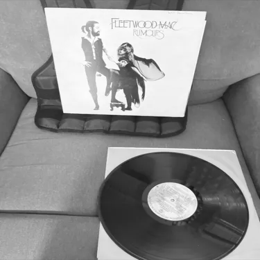

Distance from original: 0.8323963420779064


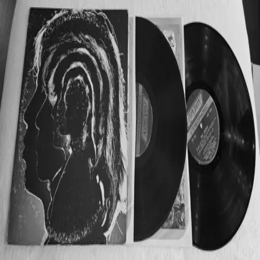

Distance from original: 0.8353536800328187


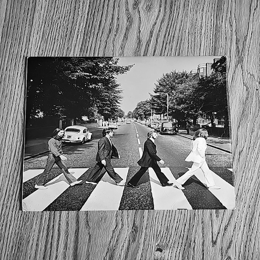

Distance from original: 0.8359852207849385


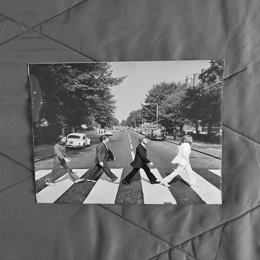

Distance from original: 0.8393271110617145


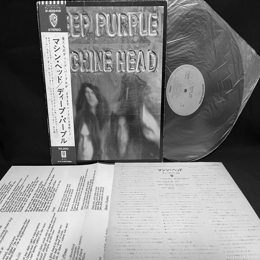

Distance from original: 0.840996236090421


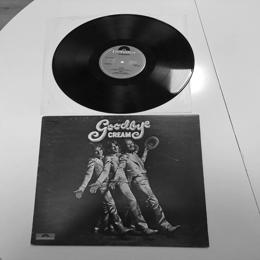

Distance from original: 0.8423155737824722


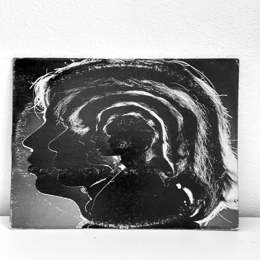

Distance from original: 0.8425415226805237


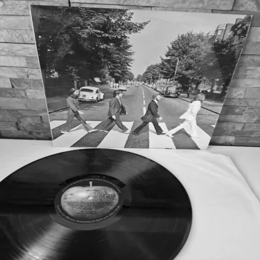

Distance from original: 0.845259933117167


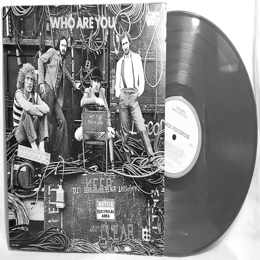

Distance from original: 0.8454898232650989


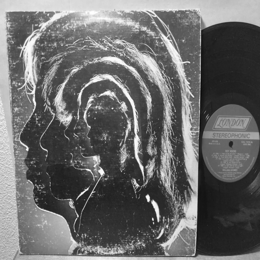

Distance from original: 0.8458679370094487


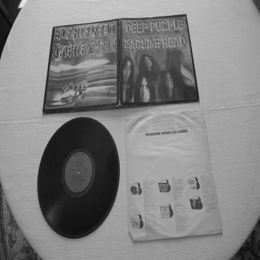

Distance from original: 0.8506435825854548


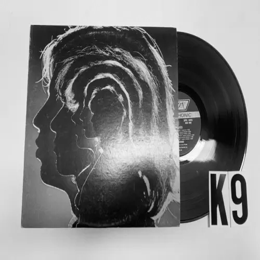

Distance from original: 0.8521311679173179


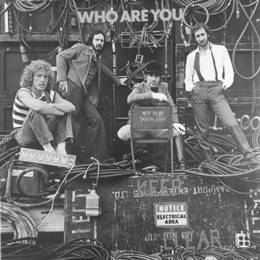

Distance from original: 0.8524322383558673


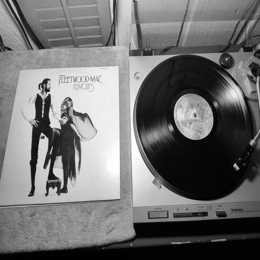

Distance from original: 0.8535291390317342


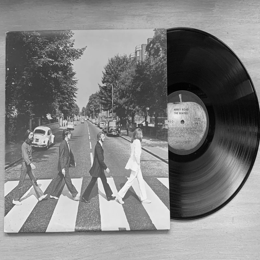

Distance from original: 0.8546697184391875


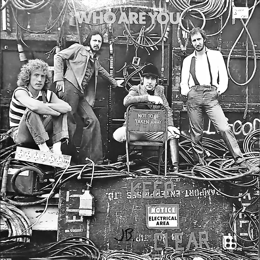

Distance from original: 0.8565987826742675


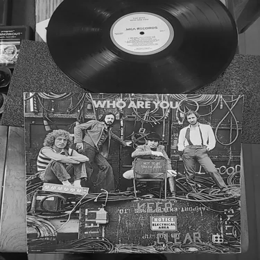

Distance from original: 0.8569981522914234


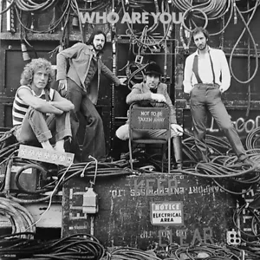

Distance from original: 0.8588615924140331


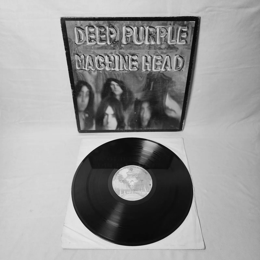

Distance from original: 0.8600487192644339


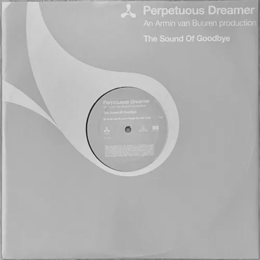

Distance from original: 0.8605820567993605


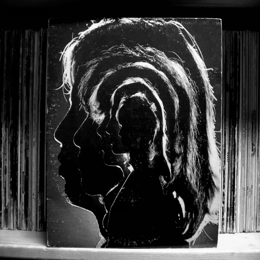

Distance from original: 0.8606839843618298


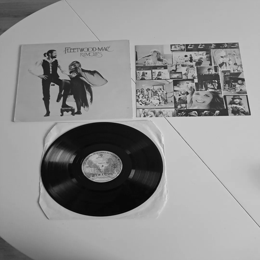

Distance from original: 0.8609756713296113


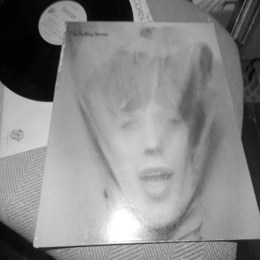

Distance from original: 0.8641927541945377


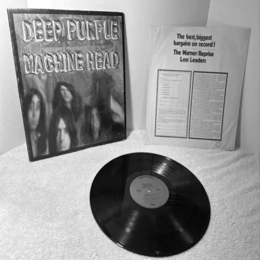

Distance from original: 0.8666554793742665


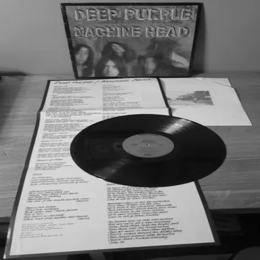

Distance from original: 0.8685604343227226


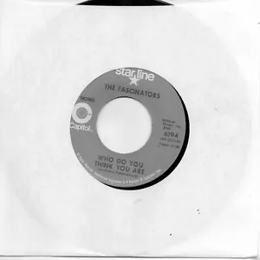

Distance from original: 0.8713239005428429


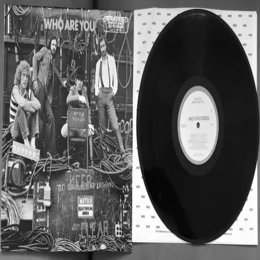

Distance from original: 0.8726649742467116


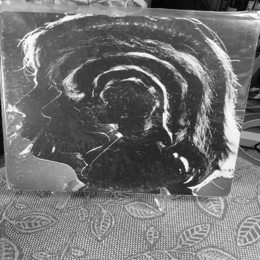

Distance from original: 0.8736512124065741


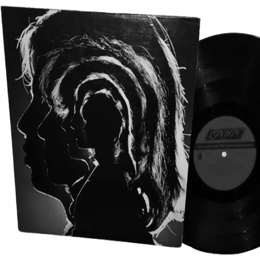

Distance from original: 0.8745149871461644


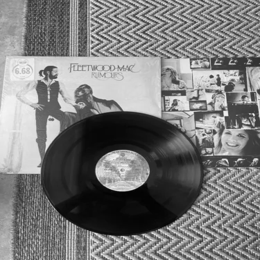

Distance from original: 0.8769911786448028


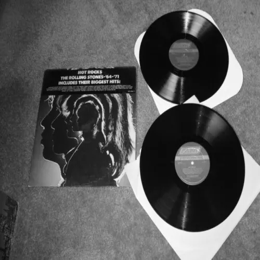

Distance from original: 0.8780046399596808


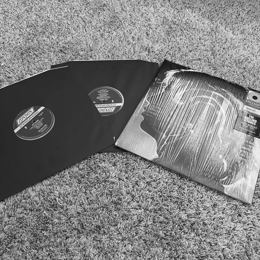

Distance from original: 0.8799050136635448


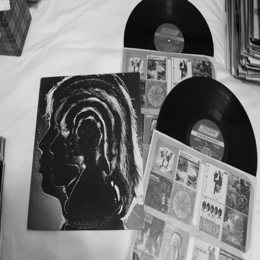

Distance from original: 0.8842351717563931


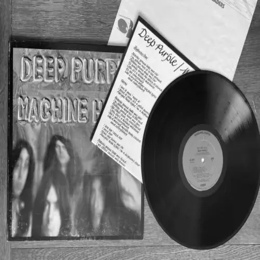

Distance from original: 0.8843521939496023


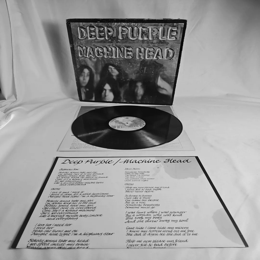

Distance from original: 0.8848649723761792


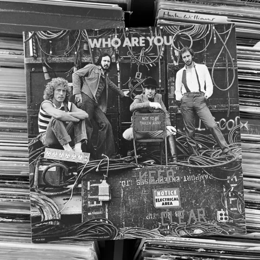

Distance from original: 0.885899590217182


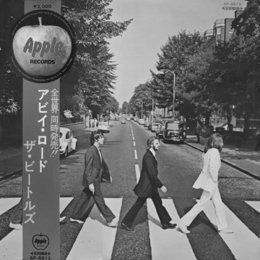

Distance from original: 0.8862025859320514


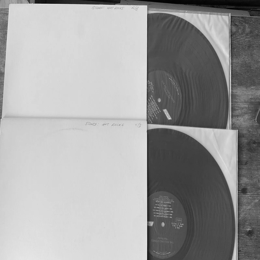

Distance from original: 0.8893855723083725


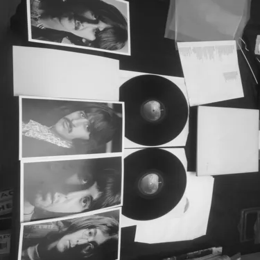

Distance from original: 0.8898501849576612


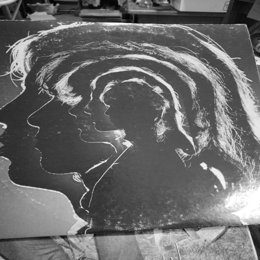

Distance from original: 0.8905674873886865


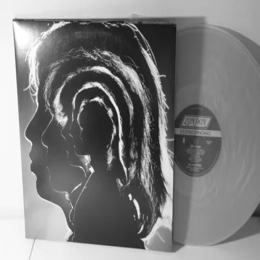

Distance from original: 0.8954327584176739


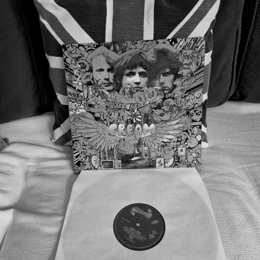

Distance from original: 0.9039643224956131


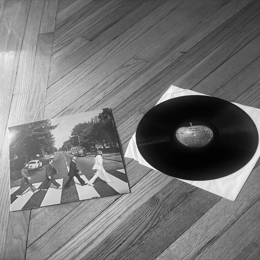

Distance from original: 0.9060994022976268


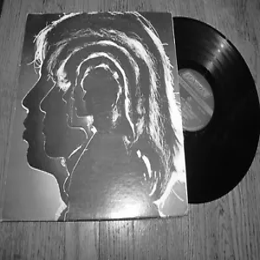

Distance from original: 0.9079525552346596


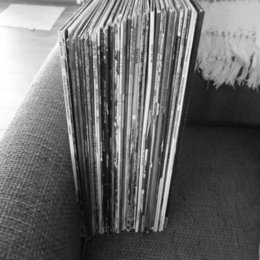

Distance from original: 0.9100017702960015


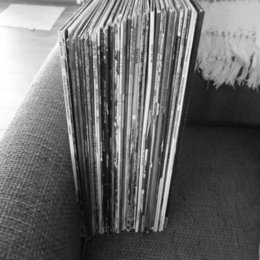

Distance from original: 0.9100017702960015


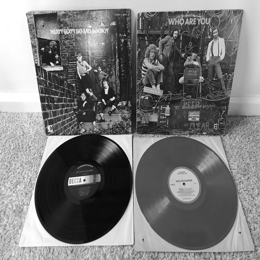

Distance from original: 0.9104925986176621


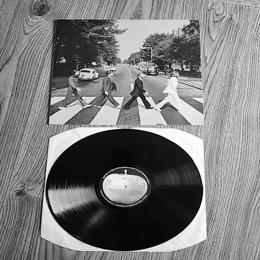

Distance from original: 0.9114168006021443


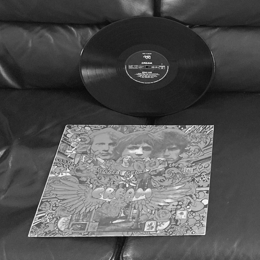

Distance from original: 0.9130234754341647


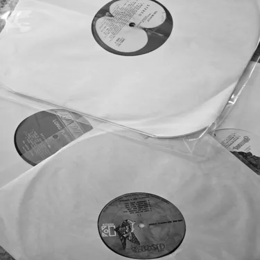

Distance from original: 0.9140763242527351


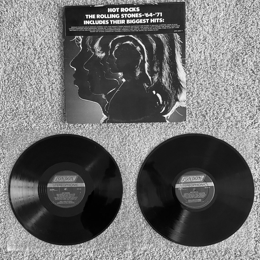

Distance from original: 0.9142312416863798


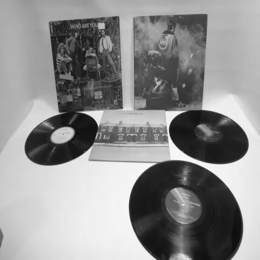

Distance from original: 0.9143518097197363


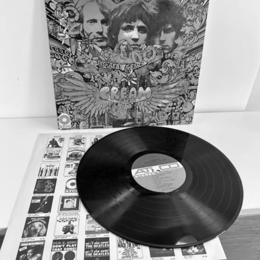

Distance from original: 0.9189832032319152


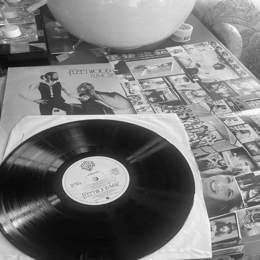

Distance from original: 0.920725430093966


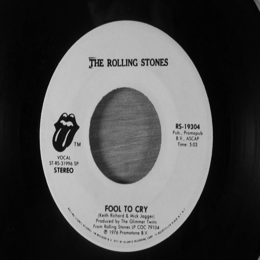

Distance from original: 0.921253479920076


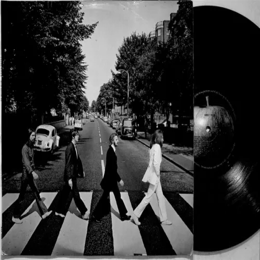

Distance from original: 0.9229727445223155


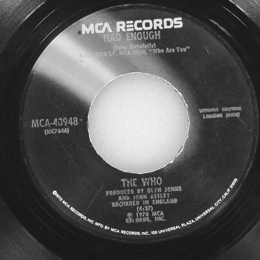

Distance from original: 0.9253359855352746


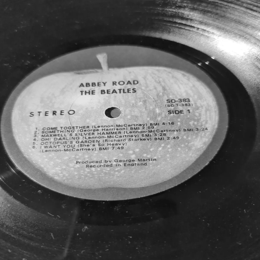

Distance from original: 0.9264718245534743


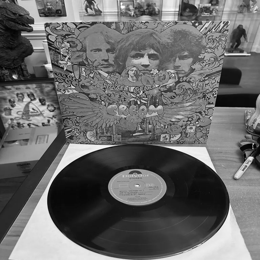

Distance from original: 0.9322868084168203


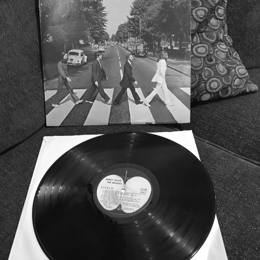

Distance from original: 0.9378477474106195


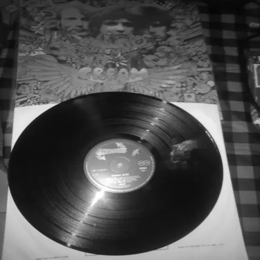

Distance from original: 0.9416071565147174


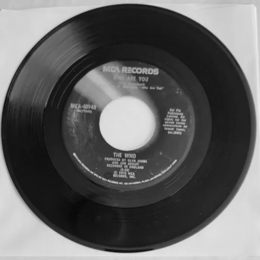

Distance from original: 0.9510617036668113


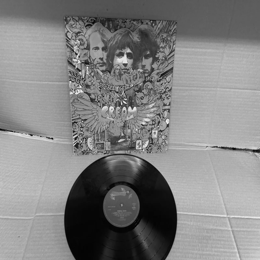

Distance from original: 0.9584654575777724


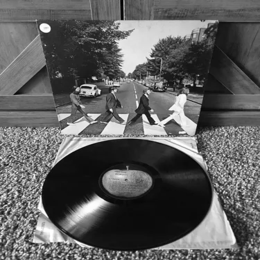

Distance from original: 0.963996493164429


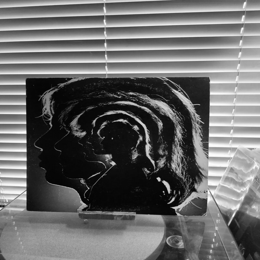

Distance from original: 0.9735420442065129


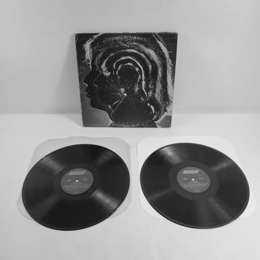

Distance from original: 0.9757955442385479


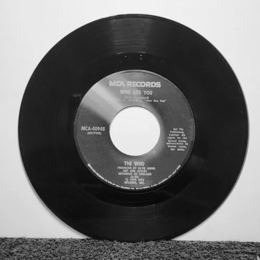

Distance from original: 0.9759859905073156


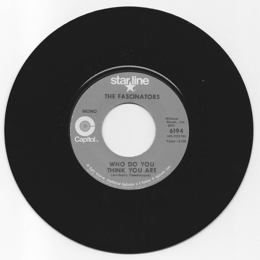

Distance from original: 0.9809013511898809


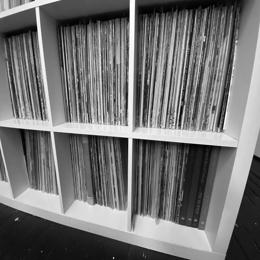

Distance from original: 0.9830773810590133


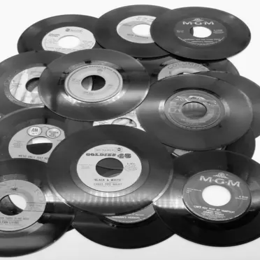

Distance from original: 0.9872999957130292


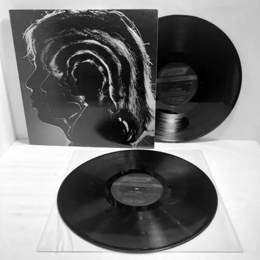

Distance from original: 0.9892641025952594


In [60]:
# display a list of top x most similar images/items with price etc:
print('Your items value based on',len(sorted_distances), 'comparable items sold is:')
print('')
print('--$',df['sold'].mean(),'--')
print('')
print('-> Min Price sold: $',df['sold'].min())
print('-> Max Price sold: $',df['sold'].max())
print(' ')
print('Details -> Top ', len(sorted_distances), ' most similar items found:')
print('')
i = 0
for image, distance in sorted_distances:
    file = Image.open('scraping/files/' + image).convert('L').resize(IMAGE_SHAPE)
    display(file)
    print('Distance from original:', distance)
#would be awesome to get a historic value of item (over past year at 1 month increments?)
#factor in other things like location, condition -> see records VG VG+ etc

## Further Analysis and Fine Tuning
Now we can see our basic model works but how good and can we improve it?  

In [10]:
#First we want to split our data so we can compare
#split data into X & Y + test train for later
X = df['image_file']
y = df['label']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, random_state=42)

In [11]:
#let's create a function to reduce the dimensions of our features into 2D using PCA & plot with plotly

def plot_embeddings(features, labels):    
    pca = TSNE(n_components=2, learning_rate='auto', init='pca')
    reduced_features = pca.fit_transform(features)
#    str_labels = list(map(int_to_class_label, labels))
    fig = px.scatter(x=reduced_features[:,0], y=reduced_features[:,1], color=labels, symbol=labels)
    fig.show()

In [12]:
#lets create a function to batch process our images for our model:
tensor_list = []
def batchpreproc(files):
 for file in files:
     file = Image.open('scraping/files/' + file).convert('L')
     file = np.stack((file,)*3, axis=-1)
     file = tf.image.resize_with_crop_or_pad(file, target_height=height, target_width=width)
     file = tf.cast(file, tf.float32) / 255.0
     tensor_list.append(file)        
 pixels = tf.stack(tensor_list, axis=0)     
 return pixels    
     

In [13]:
#let's first look at our pre trained model used to compare images above:
model_url = 'https://www.kaggle.com/models/tensorflow/efficientnet/TensorFlow2/b2-feature-vector/1'
expect_img_size = 260
layer = hub.KerasLayer(model_url, trainable=False)
model = tf.keras.Sequential([layer])
model.build([None, expect_img_size, expect_img_size, 3])  # Batch input shape.
model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer_2 (KerasLayer)  (None, 1408)              7768562   
                                                                 
Total params: 7,768,562
Trainable params: 0
Non-trainable params: 7,768,562
_________________________________________________________________


In [14]:
#pre process our images as a list of tensors so we can batch predict
X_test = batchpreproc(X_test)

### Plot of embeddings colored by class for pre trained model:

6/6 [==============================] - 3s 407ms/step


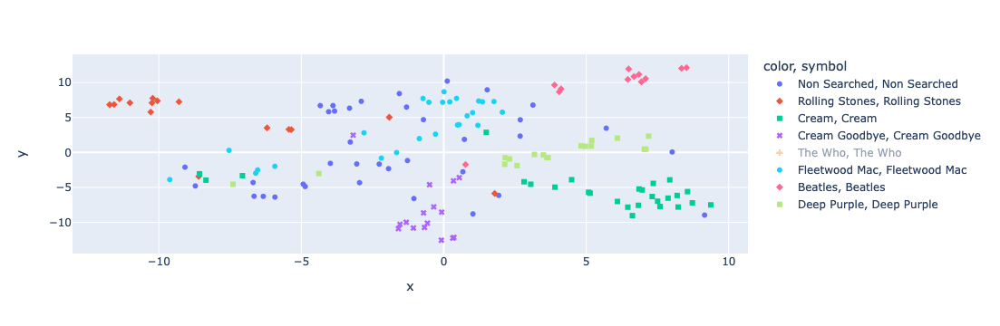

In [11]:
features_pre_trained_model = model.predict(X_test)
plot_embeddings(features=features_pre_trained_model, labels=y_test)

In [15]:
# Tuned extractor: let's try and tune our extractor using a loss function reducing the distance between similar classes
tuned_extractor = tf.keras.Sequential([
#    tf.keras.layers.RandomFlip("horizontal_and_vertical"),
#    tf.keras.layers.RandomRotation(0.2),
    hub.KerasLayer(model_url, trainable=True),
    tf.keras.layers.Dropout(0.3),
    tf.keras.layers.Dense(384, activation=None), # No activation on final dense layer
    tf.keras.layers.Lambda(lambda x: tf.math.l2_normalize(x, axis=1)) # L2 normalize embeddings
])
tuned_extractor.build([None, expect_img_size, expect_img_size, 3])
tuned_extractor.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer_3 (KerasLayer)  (None, 1408)              7768562   
                                                                 
 dropout (Dropout)           (None, 1408)              0         
                                                                 
 dense (Dense)               (None, 384)               541056    
                                                                 
 lambda (Lambda)             (None, 384)               0         
                                                                 
Total params: 8,309,618
Trainable params: 8,242,050
Non-trainable params: 67,568
_________________________________________________________________


In [16]:
#reading documentation for Facenet triplet loss we need to create our training batches of 128
#due to processing limitations we had to drastically cut to 16!
def get_training_batch(images, labels, batch_size=16, n_examples_per_class=4):
    examples_per_class = defaultdict(list)
    for x, y in zip(images, labels):
        examples_per_class[y].append(x)
    
    while True:
        batch_X, batch_y = [], []
        while len(batch_X) < batch_size:
            for cls, examples in examples_per_class.items():
                n_sample = min(n_examples_per_class, (batch_size - len(batch_X)))
                if n_sample == 0:
                    break
                samples = random.sample(examples, k=n_sample)
                batch_X.extend(samples)
                batch_y.extend([cls] * len(samples))

        yield np.array(batch_X), np.array(batch_y)

In [17]:
#we need to pre process our images as a list of tensors this time to train our model:
X_train = batchpreproc(X_train)

In [18]:
#complile and train our new model with triplet loss:
bs = 16
n_examples_per_class = 4
initial_lr = 0.0001
epochs = 12

tuned_extractor.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=initial_lr),
                         loss=tfa.losses.TripletSemiHardLoss())

history = tuned_extractor.fit(get_training_batch(images=X_train, labels=y_train, batch_size=bs, n_examples_per_class=n_examples_per_class),
                               callbacks=[tf.keras.callbacks.EarlyStopping(patience=5)],
                               epochs=epochs, 
                               steps_per_epoch=len(X_train)//bs, 
                               validation_data=(X_test, y_test),
                               validation_batch_size=bs,
                              )

Epoch 1/12
25/25 [==============================] - 49s 2s/step - loss: 1.1526 - val_loss: nan
Epoch 2/12
25/25 [==============================] - 38s 1s/step - loss: 1.1490 - val_loss: nan
Epoch 3/12
25/25 [==============================] - 39s 2s/step - loss: 1.1441 - val_loss: nan
Epoch 4/12
25/25 [==============================] - 37s 1s/step - loss: 1.1256 - val_loss: nan
Epoch 5/12
25/25 [==============================] - 37s 1s/step - loss: 1.0800 - val_loss: nan


### Plot of embeddings colored by class for optimized model:

6/6 [==============================] - 3s 421ms/step


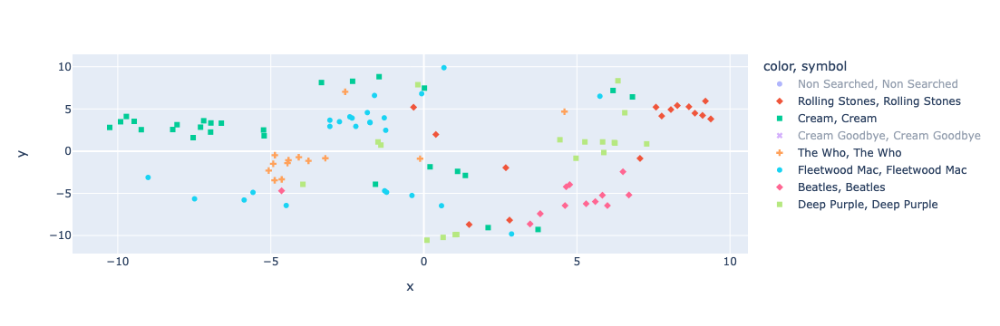

In [19]:
frozen_features = tuned_extractor.predict(X_test)
plot_embeddings(features=frozen_features, labels=y_test)

# Conclusion:

### Pretrained model:

Our pre trained model already yielded very good results that yield accurate image similarity results given the variability of images.  We also tried a ViT model that did not perform as well without transfer learning.  Inference takes as little as 10ms so can be used in production on a small dataset.  

### Fine tuned model:

Unfortunately we did not have the compute power and the kernel kept crashing until we reduced the size of the batches.  We also have very limited data so the recomended steps in FaceNet to retrain the model was not ideal for our circumstances.  Next steps would be to enlarge the dataset and use augmentation to train the model with a GPU.  This should yield the even more accurate results we are looking for.

Budget and time permitting it would also be usefull to tune hyper parameters once we get a basic trained model but also try Vision Transformers that were tried for this but performed poorly without training.

### Suggested Next steps:

Additional webscraping and annotation should be performed to train a tuned model for extracting features.  Rather than using a dataframe to store our embeddings it is also recomended to use a vector database like Pinecone, Vertex (google) or other no sql systems like Elastic Search or cCsmos to store our embeddings while maintaining performance when we have large numbers.  

The model can also be deployed as an app service with FastAPI or similar to receive a candidate image and return json details with price, similar images etc offering a viable consumer app to lookup the price of an item with a phone camera image!


